# Projet MSI : Graph Contrastive Learning for Spatial Relations

Ce projet explore l'utilisation de l'apprentissage contrastif sur graphes (Graph Contrastive Learning like), pour apprendre des représentations structurées de la spatialité des scènes à partir d'images naturelles.

L’idée centrale consiste à représenter chaque scène sous la forme d’un graphe de scène, dans lequel les objets sont modélisés comme des nœuds et les relations spatiales comme des arêtes, afin de capturer explicitement l’organisation spatiale globale de la scène.
Ici, nous représentons les noeuds sous la forme de moments statistiques, et les arêtes portant les informations de bandeaux de force, un descripteur de position relative.

Auteur : Yassine FEKIH HASSEN <br>
Encadrants : Camille Kurtz, Laurent Wendling, Logan Servant (Université Paris Cité)

---

## 1. Imports et Configuration


In [ ]:
import os
import json
import pickle
import io
import datetime
import textwrap
from pathlib import Path
from collections import Counter, defaultdict

import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, random_split
from torch.utils.tensorboard import SummaryWriter

from torch_geometric.data import Data
from torch_geometric.nn import GINConv, global_mean_pool
from torch_geometric.nn.norm import LayerNorm
from torch_geometric.loader import DataLoader as PyGDataLoader

import torchvision.models as models
import torchvision.transforms as transforms

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import (
    accuracy_score, precision_recall_fscore_support,
    classification_report, confusion_matrix
)
from sklearn.metrics.pairwise import cosine_similarity

from tqdm import tqdm
print("Imports OK")

c:\envs\env_gnn\Lib\site-packages\torch_geometric\__init__.py:4: UserWarning: An issue occurred while importing 'torch-scatter'. Disabling its usage. Stacktrace: Could not load this library: C:\envs\env_gnn\Lib\site-packages\torch_scatter\_version_cuda.pyd
  import torch_geometric.typing
c:\envs\env_gnn\Lib\site-packages\torch_geometric\__init__.py:4: UserWarning: An issue occurred while importing 'torch-cluster'. Disabling its usage. Stacktrace: Could not load this library: C:\envs\env_gnn\Lib\site-packages\torch_cluster\_version_cuda.pyd
  import torch_geometric.typing
c:\envs\env_gnn\Lib\site-packages\torch_geometric\__init__.py:4: UserWarning: An issue occurred while importing 'torch-spline-conv'. Disabling its usage. Stacktrace: Could not load this library: C:\envs\env_gnn\Lib\site-packages\torch_spline_conv\_version_cuda.pyd
  import torch_geometric.typing
c:\envs\env_gnn\Lib\site-packages\torch_geometric\__init__.py:4: UserWarning: An issue occurred while importing 'torch-sparse

Imports OK


In [73]:
# ==============================================================================
# CONFIGURATION GLOBALE
# ==============================================================================

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Device: {DEVICE}")

# Hyperparametres
BATCH_SIZE = 256
LR = 1e-4
EPOCHS = 50
NUM_ANGLES = 64
TRAINING_MODE = "graph"  # "edge"-level ou "graph"-level

# Chemins
BASE_PATH = Path("C:/Users/yassi/Desktop/MSI_Project")
SPLIT_TRAIN = BASE_PATH / "archive/Splits/Splits/scene_graphs_train.json"
SPLIT_VAL = BASE_PATH / "archive/Splits/Splits/scene_graphs_val.json"
SPLIT_TEST = BASE_PATH / "archive/Splits/Splits/scene_graphs_test.json"
BBOX_DIR = BASE_PATH / "archive/NEWProcessedPSG/NEWProcessedPSG"
COCO_IMG_ROOT = BASE_PATH / "COCO"
TRAIN_ROOT = BASE_PATH / "pyg_dataset/train"
VAL_ROOT = BASE_PATH / "pyg_dataset/val"
CACHE_DIR = BASE_PATH / "image_mapping"
CACHE_TRAIN_IMG = CACHE_DIR / "imageid_to_path_train.json"
CACHE_VAL_IMG = CACHE_DIR / "imageid_to_path_val.json"
MULTIMODAL_CACHE_DIR = BASE_PATH / "multimodal_cache"

# Fichiers de sortie
LOSS_FILE = f"loss_log_{TRAINING_MODE}.txt"
MODEL_FILE = f"dual_encoder_{TRAINING_MODE}cl.pth"
FB_INDEX_PATH = "fb_index.json"

print(f"Mode: {TRAINING_MODE.upper()}-level | Batch: {BATCH_SIZE} | LR: {LR}")

Device: cuda
Mode: GRAPH-level | Batch: 256 | LR: 0.0001


In [74]:
from torch.utils.tensorboard import SummaryWriter
import datetime

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
writer = SummaryWriter(log_dir)

---
## 2. Chargement des Donnees

Mapping entre les IDs d'images et leurs chemins.

In [ ]:
# Chargement des splits et scene graphs
with open(SPLIT_TRAIN) as f:
    train_ids = set(json.load(f))
with open(SPLIT_VAL) as f:
    val_ids = set(json.load(f))

print(f"Train: {len(train_ids)} IDs | Val: {len(val_ids)} IDs")

# Charger les scene graphs complets
with open(SPLIT_TRAIN) as f:
    scene_train = json.load(f)
with open(SPLIT_VAL) as f:
    scene_val = json.load(f)
with open(SPLIT_TEST) as f:
    scene_test = json.load(f)

# Index FB
with open(FB_INDEX_PATH, "r") as f:
    FB_INDEX = json.load(f)

Train: 38999 IDs | Val: 4874 IDs


In [ ]:
# Mapping image id -> chemin rgb avec cache
def build_image_mapping(split_ids, cache_path):
    """Construit le mapping {image_id: chemin_RGB} avec cache."""
    if cache_path.exists():
        with open(cache_path) as f:
            return {k: Path(v) for k, v in json.load(f).items()}, 0

    imageid_to_path, skipped = {}, 0
    for img_id in tqdm(split_ids, desc=f"Mapping ({cache_path.stem})"):
        bbox_file = BBOX_DIR / img_id / f"{img_id}_bboxes.json"
        if not bbox_file.exists():
            skipped += 1
            continue
        with open(bbox_file) as f:
            data = json.load(f)
        for entry in data:
            if "image_file" not in entry:
                continue
            full_path = COCO_IMG_ROOT / entry["image_file"]
            if full_path.exists():
                imageid_to_path[img_id] = full_path
            else:
                skipped += 1
            break

    cache_path.parent.mkdir(parents=True, exist_ok=True)
    with open(cache_path, "w") as f:
        json.dump({k: str(v) for k, v in imageid_to_path.items()}, f)
    return imageid_to_path, skipped

imageid_to_path_train, _ = build_image_mapping(train_ids, CACHE_TRAIN_IMG)
imageid_to_path_val, _ = build_image_mapping(val_ids, CACHE_VAL_IMG)

print(f"Train: {len(imageid_to_path_train)} images | Val: {len(imageid_to_path_val)} images")

Train: 38999 images | Val: 4874 images


---
## 3. Definition des classes et modèles

Architecture du GNN et composants auxiliaires.

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from pathlib import Path
from torch.utils.data import Dataset
from torch_geometric.data import Data
from torch_geometric.nn import GINConv, global_mean_pool
from torch_geometric.nn.norm import LayerNorm


class PSGDataset(Dataset):
    def __init__(self, root, scene_graph_json):
        self.root = Path(root)
        self.processed_file = self.root / "processed" / "graphs_dict.pt"
        if self.processed_file.exists():
            self.data_list = torch.load(self.processed_file, weights_only=False)
        else:
            raise FileNotFoundError(f"Fichier non trouvé : {self.processed_file}. Lancez la construction d'abord !")

    def __len__(self):
        return len(self.data_list)

    def __getitem__(self, idx):
        d = self.data_list[idx]
        return Data(
            x=d["x"],
            edge_index=d["edge_index"],
            edge_attr=d["edge_attr"],
            img_id=d["img_id"],
        )


class EdgeAugmentor:
    def __init__(
        self,
        noise_std=0.3,
        shift_prob=0.5,
        max_shift=16,
        blur_prob=0.3,
        blur_kernel_size=3,
        num_angles=64,
    ):
        self.noise_std = noise_std
        self.shift_prob = shift_prob
        self.max_shift = max_shift
        self.blur_prob = blur_prob
        self.blur_kernel_size = blur_kernel_size
        self.num_angles = num_angles
        self.last_flags = {}

    def angular_shift(self, fb):
        applied = False
        if torch.rand(1).item() <= self.shift_prob:
            applied = True
            R = fb.numel() // self.num_angles
            fb = fb.view(R, self.num_angles)
            shift = torch.randint(-self.max_shift, self.max_shift + 1, (1,)).item()
            fb = torch.roll(fb, shifts=shift, dims=1)
            fb = fb.view(-1)
        return fb, applied

    def angular_blur(self, fb):
        applied = False
        if torch.rand(1).item() <= self.blur_prob:
            applied = True
            R = fb.numel() // self.num_angles
            fb = fb.view(R, 1, self.num_angles)
            kernel = torch.ones(1, 1, self.blur_kernel_size, device=fb.device) / self.blur_kernel_size
            pad = self.blur_kernel_size // 2
            fb = F.pad(fb, (pad, pad), mode="circular")
            fb = F.conv1d(fb, kernel)
            fb = fb.view(-1)
        return fb, applied

    def __call__(self, batch):
        v1 = batch.clone()
        v2 = batch.clone()

        use_noise = self.noise_std > 0
        if use_noise:
            v1.edge_attr = v1.edge_attr + torch.randn_like(v1.edge_attr) * self.noise_std
            v2.edge_attr = v2.edge_attr + torch.randn_like(v2.edge_attr) * self.noise_std

        shift_used = False
        blur_used = False

        new_v1 = []
        new_v2 = []

        for e in v1.edge_attr:
            e, s1 = self.angular_shift(e)
            e, b1 = self.angular_blur(e)
            shift_used |= s1
            blur_used |= b1
            new_v1.append(e)

        for e in v2.edge_attr:
            e, s2 = self.angular_shift(e)
            e, b2 = self.angular_blur(e)
            shift_used |= s2
            blur_used |= b2
            new_v2.append(e)

        v1.edge_attr = torch.stack(new_v1)
        v2.edge_attr = torch.stack(new_v2)

        self.last_flags = {"noise": use_noise, "shift": shift_used, "blur": blur_used}
        return v1, v2


class DualEncoderEdgeCL(nn.Module):
    """
    Architecture SimCLR pour les embeddings d'arêtes :
    - encode() : Encodeur f(·) -> h (representation des arêtes)
    - project() : Projection head g(·) : h -> z
    - Contrastive loss calculée sur z
    - Downstream tasks utilisent h (sans projection)
    """
    def __init__(self, node_dim, edge_dim, hidden_dim=256, dropout=0.1, proj_dim=128):
        super().__init__()

        self.node_proj = nn.Sequential(
            nn.Linear(node_dim, hidden_dim),
            LayerNorm(hidden_dim),
            nn.ReLU(),
            nn.Dropout(dropout),
        )

        self.content_enc = nn.Sequential(
            nn.Linear(edge_dim, 2 * hidden_dim),
            LayerNorm(2 * hidden_dim),
            nn.ReLU(),
            nn.Dropout(dropout),
            nn.Linear(2 * hidden_dim, hidden_dim),
            LayerNorm(hidden_dim),
            nn.ReLU(),
        )

        self.conv1 = GINConv(nn.Sequential(nn.Linear(hidden_dim, hidden_dim), nn.ReLU(), nn.Linear(hidden_dim, hidden_dim)))
        self.conv2 = GINConv(nn.Sequential(nn.Linear(hidden_dim, hidden_dim), nn.ReLU(), nn.Linear(hidden_dim, hidden_dim)))
        self.conv3 = GINConv(nn.Sequential(nn.Linear(hidden_dim, hidden_dim), nn.ReLU(), nn.Linear(hidden_dim, hidden_dim)))

        self.norm1 = LayerNorm(hidden_dim)
        self.norm2 = LayerNorm(hidden_dim)
        self.norm3 = LayerNorm(hidden_dim)

        # Encodeur final (produit h)
        self.fuse_mlp = nn.Sequential(
            nn.Linear(3 * hidden_dim, 4 * hidden_dim),
            nn.ReLU(),
            nn.Linear(4 * hidden_dim, 2 * hidden_dim),
            nn.ReLU(),
            nn.Linear(2 * hidden_dim, hidden_dim),
        )

        # ========== PROJECTION HEAD (comme SimCLR) ==========
        # Projette h -> z pour le contrastif
        self.projection_head = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, proj_dim),
        )

        self.readout = nn.Sequential(
            nn.Linear(hidden_dim, hidden_dim),
            nn.ReLU(),
        )

    def encode(self, data):
        """
        Encodeur f(·) -> h (representation des arêtes)
        À utiliser pour les downstream tasks
        """
        x, edge_index, edge_attr = data.x, data.edge_index, data.edge_attr

        x = self.node_proj(x)

        h1 = self.conv1(x, edge_index)
        h1 = self.norm1(h1 + x)
        h1 = F.relu(h1)

        h2 = self.conv2(h1, edge_index)
        h2 = self.norm2(h2 + h1)
        h2 = F.relu(h2)

        h3 = self.conv3(h2, edge_index)
        h3 = self.norm3(h3 + h2)
        h3 = F.relu(h3)

        c = self.content_enc(edge_attr)

        row, col = edge_index
        edge_rep = torch.cat([h3[row], h3[col], c], dim=1)
        h = self.fuse_mlp(edge_rep)
        return h

    def project(self, h):
        """
        Projection head g(·) : h -> z
        À utiliser uniquement pour le contrastive loss
        """
        return self.projection_head(h)

    def get_edge_embeddings(self, data):
        """
        encode + project
        """
        h = self.encode(data)
        z = self.project(h)
        return z

    def get_graph_embedding(self, data):
        """Graph-level"""
        x, edge_index, edge_attr = data.x, data.edge_index, data.edge_attr
        
        # Encoder nodes
        x = self.node_proj(x)
        h1 = self.conv1(x, edge_index)
        h1 = self.norm1(h1 + x)
        h1 = F.relu(h1)
        
        h2 = self.conv2(h1, edge_index)
        h2 = self.norm2(h2 + h1)
        h2 = F.relu(h2)
        
        h3 = self.conv3(h2, edge_index)
        h3 = self.norm3(h3 + h2)
        h3 = F.relu(h3)
        
        c = self.content_enc(edge_attr)
        row, col = edge_index
        edge_rep = torch.cat([h3[row], h3[col], c], dim=1)
        h_edges = self.fuse_mlp(edge_rep)
        
        if hasattr(data, 'batch') and data.batch is not None:
            batch = data.batch
        else:
            batch = torch.zeros(h3.size(0), dtype=torch.long, device=h3.device)
        
        edge_batch = batch[row]

        # Pooling combiné 
        node_pooled = global_mean_pool(h3, batch)
        edge_pooled = global_mean_pool(h_edges, edge_batch)
        combined = (node_pooled + edge_pooled) / 2 
        z = self.readout(combined)
        z = F.normalize(z, dim=-1)
        return z

# Loss Contrastive InfoNCE avec temperature
def info_nce_loss(z1, z2, temperature=0.1):
    z1 = F.normalize(z1, dim=1)
    z2 = F.normalize(z2, dim=1)
    pos_sim = (z1 * z2).sum(dim=1) / temperature
    all_sim = torch.mm(z1, z2.t()) / temperature
    loss = -pos_sim + torch.logsumexp(all_sim, dim=1)
    return loss.mean()


---
## 4. Preparation des Dataloaders

In [ ]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from pathlib import Path
from tqdm import tqdm
from torch.utils.data import Dataset, random_split
from torch_geometric.loader import DataLoader
import matplotlib.pyplot as plt


# Configueration globale
DEVICE = torch.device("cpu")
BATCH_SIZE = 256
LR = 1e-4
EPOCHS = 50

# CHOIX STRATEGIE D'APPRENTISSAGE : "edge" level ou "graph" level
TRAINING_MODE = "edge" 

TRAIN_ROOT = "C:/Users/yassi/Desktop/MSI_Project/pyg_dataset/train"
TRAIN_JSON = "C:/Users/yassi/Desktop/MSI_Project/archive/Splits/Splits/scene_graphs_train.json"
VAL_ROOT   = "C:/Users/yassi/Desktop/MSI_Project/pyg_dataset/val"

LOSS_FILE = f"loss_log_{TRAINING_MODE}.txt"
MODEL_FILE = f"dual_encoder_{TRAINING_MODE}cl.pth"


# dataset + split
dataset = PSGDataset(TRAIN_ROOT, TRAIN_JSON)

train_size = int(0.8 * len(dataset))
val_size   = len(dataset) - train_size
train_set, val_set = random_split(dataset, [train_size, val_size], generator=torch.Generator().manual_seed(42))

train_loader = DataLoader(train_set, batch_size=BATCH_SIZE, shuffle=True)
val_loader   = DataLoader(val_set, batch_size=BATCH_SIZE, shuffle=False)


sample_batch = next(iter(train_loader))
NODE_DIM = sample_batch.x.size(1)
EDGE_DIM = sample_batch.edge_attr.size(1)

# optim + model
NUM_ANGLES = 64

model = DualEncoderEdgeCL(
    node_dim=NODE_DIM,
    edge_dim=EDGE_DIM,
    hidden_dim=128
).to(DEVICE)

---
## 5. Entrainement du modèle contrastif


   MODE D'ENTRAÎNEMENT : EDGE-LEVEL



[Val] Epoch 1/50: 100%|██████████| 30/30 [00:08<00:00,  3.59it/s]


Epoch 01 | Train: 2.4328 | Val: 0.7780


[Val] Epoch 2/50: 100%|██████████| 30/30 [00:08<00:00,  3.69it/s]


Epoch 02 | Train: 0.6879 | Val: 0.4642


[Val] Epoch 3/50: 100%|██████████| 30/30 [00:07<00:00,  3.86it/s]


Epoch 03 | Train: 0.4777 | Val: 0.3737


[Val] Epoch 4/50: 100%|██████████| 30/30 [00:07<00:00,  3.84it/s]


Epoch 04 | Train: 0.3968 | Val: 0.3280


[Val] Epoch 5/50: 100%|██████████| 30/30 [00:08<00:00,  3.56it/s]


Epoch 05 | Train: 0.3533 | Val: 0.2961


[Val] Epoch 6/50: 100%|██████████| 30/30 [00:08<00:00,  3.66it/s]


Epoch 06 | Train: 0.3247 | Val: 0.2762


[Val] Epoch 7/50: 100%|██████████| 30/30 [00:08<00:00,  3.62it/s]


Epoch 07 | Train: 0.3034 | Val: 0.2610


[Val] Epoch 8/50: 100%|██████████| 30/30 [00:08<00:00,  3.63it/s]


Epoch 08 | Train: 0.2885 | Val: 0.2529


[Val] Epoch 9/50: 100%|██████████| 30/30 [00:08<00:00,  3.52it/s]


Epoch 09 | Train: 0.2750 | Val: 0.2452


[Val] Epoch 10/50: 100%|██████████| 30/30 [00:07<00:00,  3.77it/s]


Epoch 10 | Train: 0.2661 | Val: 0.2387


[Val] Epoch 11/50: 100%|██████████| 30/30 [00:06<00:00,  4.47it/s]


Epoch 11 | Train: 0.2574 | Val: 0.2322


[Val] Epoch 12/50: 100%|██████████| 30/30 [00:06<00:00,  4.87it/s]


Epoch 12 | Train: 0.2505 | Val: 0.2260


[Val] Epoch 13/50: 100%|██████████| 30/30 [00:08<00:00,  3.56it/s]


Epoch 13 | Train: 0.2446 | Val: 0.2213


[Val] Epoch 14/50: 100%|██████████| 30/30 [00:08<00:00,  3.60it/s]


Epoch 14 | Train: 0.2392 | Val: 0.2181


[Val] Epoch 15/50: 100%|██████████| 30/30 [00:08<00:00,  3.66it/s]


Epoch 15 | Train: 0.2346 | Val: 0.2157


[Val] Epoch 16/50: 100%|██████████| 30/30 [00:08<00:00,  3.67it/s]


Epoch 16 | Train: 0.2307 | Val: 0.2120


[Val] Epoch 17/50: 100%|██████████| 30/30 [00:07<00:00,  3.80it/s]


Epoch 17 | Train: 0.2271 | Val: 0.2096


[Val] Epoch 18/50: 100%|██████████| 30/30 [00:08<00:00,  3.55it/s]


Epoch 18 | Train: 0.2241 | Val: 0.2053


[Val] Epoch 19/50: 100%|██████████| 30/30 [00:09<00:00,  3.26it/s]


Epoch 19 | Train: 0.2216 | Val: 0.2044


[Val] Epoch 20/50: 100%|██████████| 30/30 [00:08<00:00,  3.65it/s]


Epoch 20 | Train: 0.2186 | Val: 0.2024


[Val] Epoch 21/50: 100%|██████████| 30/30 [00:07<00:00,  3.78it/s]


Epoch 21 | Train: 0.2166 | Val: 0.2003


[Val] Epoch 22/50: 100%|██████████| 30/30 [00:09<00:00,  3.22it/s]


Epoch 22 | Train: 0.2146 | Val: 0.1996


[Val] Epoch 23/50: 100%|██████████| 30/30 [00:08<00:00,  3.73it/s]


Epoch 23 | Train: 0.2122 | Val: 0.1974


[Val] Epoch 24/50: 100%|██████████| 30/30 [00:08<00:00,  3.71it/s]


Epoch 24 | Train: 0.2103 | Val: 0.1969


[Val] Epoch 25/50: 100%|██████████| 30/30 [00:08<00:00,  3.67it/s]


Epoch 25 | Train: 0.2087 | Val: 0.1947


[Val] Epoch 26/50: 100%|██████████| 30/30 [00:07<00:00,  3.88it/s]


Epoch 26 | Train: 0.2069 | Val: 0.1939


[Val] Epoch 27/50: 100%|██████████| 30/30 [00:07<00:00,  3.94it/s]


Epoch 27 | Train: 0.2060 | Val: 0.1927


[Val] Epoch 28/50: 100%|██████████| 30/30 [00:07<00:00,  3.85it/s]


Epoch 28 | Train: 0.2042 | Val: 0.1909


[Val] Epoch 29/50: 100%|██████████| 30/30 [00:07<00:00,  3.95it/s]


Epoch 29 | Train: 0.2030 | Val: 0.1895


[Val] Epoch 30/50: 100%|██████████| 30/30 [00:08<00:00,  3.65it/s]


Epoch 30 | Train: 0.2020 | Val: 0.1888


[Val] Epoch 31/50: 100%|██████████| 30/30 [00:07<00:00,  3.77it/s]


Epoch 31 | Train: 0.2006 | Val: 0.1882


[Val] Epoch 32/50: 100%|██████████| 30/30 [00:06<00:00,  4.71it/s]


Epoch 32 | Train: 0.2000 | Val: 0.1877


[Val] Epoch 33/50: 100%|██████████| 30/30 [00:06<00:00,  4.52it/s]


Epoch 33 | Train: 0.1991 | Val: 0.1867


[Val] Epoch 34/50: 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]


Epoch 34 | Train: 0.1976 | Val: 0.1861


[Val] Epoch 35/50: 100%|██████████| 30/30 [00:08<00:00,  3.64it/s]


Epoch 35 | Train: 0.1967 | Val: 0.1857


[Val] Epoch 36/50: 100%|██████████| 30/30 [00:08<00:00,  3.62it/s]


Epoch 36 | Train: 0.1963 | Val: 0.1871


[Val] Epoch 37/50: 100%|██████████| 30/30 [00:08<00:00,  3.62it/s]


Epoch 37 | Train: 0.1957 | Val: 0.1856


[Val] Epoch 38/50: 100%|██████████| 30/30 [00:08<00:00,  3.69it/s]


Epoch 38 | Train: 0.1945 | Val: 0.1831


[Val] Epoch 39/50: 100%|██████████| 30/30 [00:07<00:00,  3.81it/s]


Epoch 39 | Train: 0.1941 | Val: 0.1836


[Val] Epoch 40/50: 100%|██████████| 30/30 [00:06<00:00,  4.49it/s]


Epoch 40 | Train: 0.1931 | Val: 0.1826


[Val] Epoch 41/50: 100%|██████████| 30/30 [00:06<00:00,  4.52it/s]


Epoch 41 | Train: 0.1924 | Val: 0.1829


[Val] Epoch 42/50: 100%|██████████| 30/30 [00:07<00:00,  4.10it/s]


Epoch 42 | Train: 0.1919 | Val: 0.1817


[Val] Epoch 43/50: 100%|██████████| 30/30 [00:07<00:00,  3.78it/s]


Epoch 43 | Train: 0.1913 | Val: 0.1812


[Val] Epoch 44/50: 100%|██████████| 30/30 [00:08<00:00,  3.74it/s]


Epoch 44 | Train: 0.1907 | Val: 0.1812


[Val] Epoch 45/50: 100%|██████████| 30/30 [00:07<00:00,  3.76it/s]


Epoch 45 | Train: 0.1903 | Val: 0.1800


[Val] Epoch 46/50: 100%|██████████| 30/30 [00:07<00:00,  3.87it/s]


Epoch 46 | Train: 0.1895 | Val: 0.1801


[Val] Epoch 47/50: 100%|██████████| 30/30 [00:08<00:00,  3.67it/s]


Epoch 47 | Train: 0.1889 | Val: 0.1799


[Val] Epoch 48/50: 100%|██████████| 30/30 [00:08<00:00,  3.73it/s]


Epoch 48 | Train: 0.1887 | Val: 0.1791


[Val] Epoch 49/50: 100%|██████████| 30/30 [00:07<00:00,  3.75it/s]


Epoch 49 | Train: 0.1882 | Val: 0.1791


[Val] Epoch 50/50: 100%|██████████| 30/30 [00:08<00:00,  3.45it/s]

Epoch 50 | Train: 0.1875 | Val: 0.1781

Modèle sauvegardé : dual_encoder_edgecl.pth


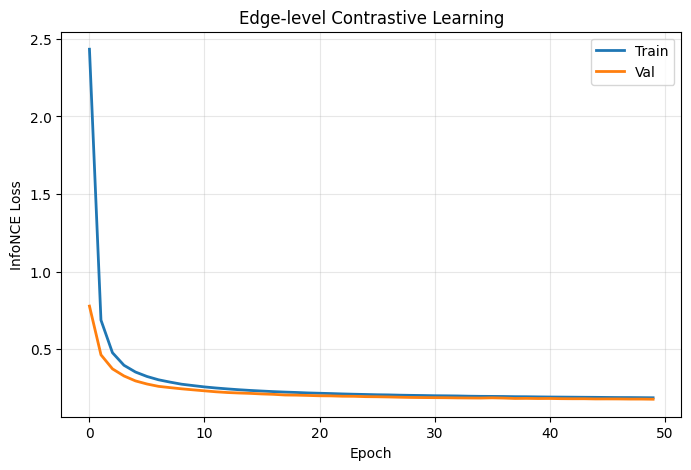

Courbes sauvegardées : training_curves_edge.png



In [ ]:
optimizer = torch.optim.Adam(model.parameters(), lr=LR)

augmentor = EdgeAugmentor(
    noise_std=0.1,
    shift_prob=0.5,
    max_shift=NUM_ANGLES // 4,
    blur_prob=0.3,
    blur_kernel_size=3,
    num_angles=NUM_ANGLES
)


# Fonction d'embedding 
def get_embeddings(model, data, mode):
    """
    Retourne embeddings selon le mode :
    - "edge" : [num_edges, proj_dim]
    - "graph" : [batch_size, hidden_dim]
    """
    if mode == "edge":
        return model.get_edge_embeddings(data)
    elif mode == "graph":
        return model.get_graph_embedding(data)
    else:
        raise ValueError(f"Mode invalide : {mode}. Utilisez 'edge' ou 'graph'.")


# Training loop 
print(f"\n{'='*60}")
print(f"   MODE D'ENTRAÎNEMENT : {TRAINING_MODE.upper()}-LEVEL")
print(f"{'='*60}\n")

train_losses = []
val_losses = []

with open(LOSS_FILE, "w") as f:
    f.write("epoch,train_loss,val_loss\n")

for epoch in range(EPOCHS):
    
    # -------- TRAIN --------
    model.train()
    total_train = 0.0

    for batch in tqdm(train_loader, desc=f"[Train] Epoch {epoch+1}/{EPOCHS}"):
        batch = batch.to(DEVICE)

        view1, view2 = augmentor(batch)

        z1 = get_embeddings(model, view1, TRAINING_MODE)
        z2 = get_embeddings(model, view2, TRAINING_MODE)

        loss = info_nce_loss(z1, z2)

        optimizer.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()

        total_train += loss.item()

    avg_train = total_train / len(train_loader)
    writer.add_scalar('Loss/train', avg_train, epoch)

    train_losses.append(avg_train)

    # -------- VAL --------
    model.eval()
    total_val = 0.0

    with torch.no_grad():
        for batch in tqdm(val_loader, desc=f"[Val] Epoch {epoch+1}/{EPOCHS}"):
            batch = batch.to(DEVICE)

            view1, view2 = augmentor(batch)
            z1 = get_embeddings(model, view1, TRAINING_MODE)
            z2 = get_embeddings(model, view2, TRAINING_MODE)

            loss = info_nce_loss(z1, z2)
            total_val += loss.item()

    avg_val = total_val / len(val_loader)
    writer.add_scalar('Loss/val', avg_val, epoch)
    val_losses.append(avg_val)

    print(
        f"Epoch {epoch+1:02d} | "
        f"Train: {avg_train:.4f} | "
        f"Val: {avg_val:.4f}"
    )

    with open(LOSS_FILE, "a") as f:
        f.write(f"{epoch+1},{avg_train},{avg_val}\n")


# Sauvegarde du modèle
torch.save(model.state_dict(), MODEL_FILE)
print(f"\nModèle sauvegardé : {MODEL_FILE}")


# loss plot
plt.figure(figsize=(8, 5))
plt.plot(train_losses, label='Train', linewidth=2, color='tab:blue')
plt.plot(val_losses, label='Val', linewidth=2, color='tab:orange')
plt.xlabel('Epoch')
plt.ylabel('InfoNCE Loss')
plt.title(f'{TRAINING_MODE.capitalize()}-level Contrastive Learning')
plt.legend()
plt.grid(True, alpha=0.3)
plt.savefig(f'training_curves_{TRAINING_MODE}.png')
plt.show()

print(f"Courbes sauvegardées : training_curves_{TRAINING_MODE}.png\n")


### Visualisation des courbes de perte

**Note**: Pour lancer TensorBoard: `tensorboard --logdir=logs`

---
## 6. Chargement du Modele Pre-entraine

In [91]:
# load saved model
model.load_state_dict(torch.load("dual_encoder_edgecl.pth", map_location=DEVICE))


<All keys matched successfully>

---
## 7. Evaluation par Linear Probing

### 7.1 Construction des datasets pour le probing

In [ ]:
# load json scene graphs splits
import json

TRAIN_JSON = "C:/Users/yassi/Desktop/MSI_Project/archive/Splits/Splits/scene_graphs_train.json"
VAL_JSON   = "C:/Users/yassi/Desktop/MSI_Project/archive/Splits/Splits/scene_graphs_val.json"
TEST_JSON  = "C:/Users/yassi/Desktop/MSI_Project/archive/Splits/Splits/scene_graphs_test.json"

with open(TRAIN_JSON, "r") as f: scene_train = json.load(f)
with open(VAL_JSON,   "r") as f: scene_val   = json.load(f)
with open(TEST_JSON,  "r") as f: scene_test  = json.load(f)

def build_rel_to_idx(scene_graphs):
    rels = set()
    for img_id, scene in scene_graphs.items():
        for r in scene["relations"]:
            rels.add(r["predicate"])
    rels = sorted(list(rels))
    rel_to_idx = {r:i for i,r in enumerate(rels)}
    return rel_to_idx, rels

REL_TO_IDX, IDX_TO_REL_LIST = build_rel_to_idx(scene_train)
IDX_TO_REL = {i:r for r,i in REL_TO_IDX.items()}

print("Nombre de relations supervisées :", len(REL_TO_IDX))


from torch.utils.data import Dataset
from torch_geometric.data import Data
from tqdm import tqdm
import torch

class EdgeRelationDataset(Dataset):
    def __init__(self, base_dataset, scene_graphs, rel_to_idx, gnn_model, device="cpu"):
        self.samples = []
        gnn_model.eval()

        for g in tqdm(base_dataset):
            img_id = str(g.img_id)
            scene = scene_graphs.get(img_id, None)
            if scene is None:
                continue

            objs = scene["objects"]
            rels = scene["relations"]

            seg_to_node = {o["segment_id"]: i for i, o in enumerate(objs)}

            gold = {}
            for r in rels:
                pred = r["predicate"]
                if pred not in rel_to_idx:
                    continue
                segA = r["subject_id"]
                segB = r["object_id"]
                if segA not in seg_to_node or segB not in seg_to_node:
                    continue
                u = seg_to_node[segA]
                v = seg_to_node[segB]
                gold[(u, v)] = (rel_to_idx[pred], segA, segB)

            if len(gold) == 0:
                continue

            with torch.no_grad():
                h_edges = gnn_model.encode(g.to(device)).cpu()

            edge_uv = g.edge_index.t().tolist()

            for edge_idx, (u, v) in enumerate(edge_uv):
                key = (u, v)
                if key not in gold:
                    continue
                lbl, segA, segB = gold[key]
                emb = h_edges[edge_idx]  
                self.samples.append((emb, int(lbl), img_id, int(edge_idx), int(u), int(v), str(segA), str(segB)))

        print("Total samples :", len(self.samples))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        emb, lbl, img_id, edge_idx, u, v, segA, segB = self.samples[idx]
        return emb, torch.tensor(lbl), img_id, edge_idx, u, v, segA, segB


# on réutilise le modèle déjà entraîné
model.eval()  # mode évaluation
for param in model.parameters():
    param.requires_grad = False  # geler

print("Modèle gelé\n")

# construction dataset
train_dataset = PSGDataset(TRAIN_ROOT, TRAIN_JSON)
val_dataset   = PSGDataset(VAL_ROOT,  VAL_JSON)

train_probe = EdgeRelationDataset(train_dataset, scene_train, REL_TO_IDX, model, device=DEVICE)
val_probe   = EdgeRelationDataset(val_dataset,   scene_val,   REL_TO_IDX, model, device=DEVICE)

from torch.utils.data import DataLoader as TorchDataLoader

loader_train = TorchDataLoader(train_probe, batch_size=512, shuffle=True)
loader_val   = TorchDataLoader(val_probe,   batch_size=512, shuffle=False)

print("Taille train :", len(train_probe))
print("Taille val   :", len(val_probe))


Nombre de relations supervisées : 56
Modèle gelé



100%|██████████| 38258/38258 [00:39<00:00, 961.21it/s] 


Total samples : 215679


100%|██████████| 4787/4787 [00:04<00:00, 959.98it/s] 


Total samples : 26850
Taille train : 215679
Taille val   : 26850


### 7.2 Visualisation t-SNE des embeddings

In [93]:
print(len(val_probe))

26850



=== Visualisation t-SNE des embeddings h ===
Calcul t-SNE...
Nombre de classes : 54


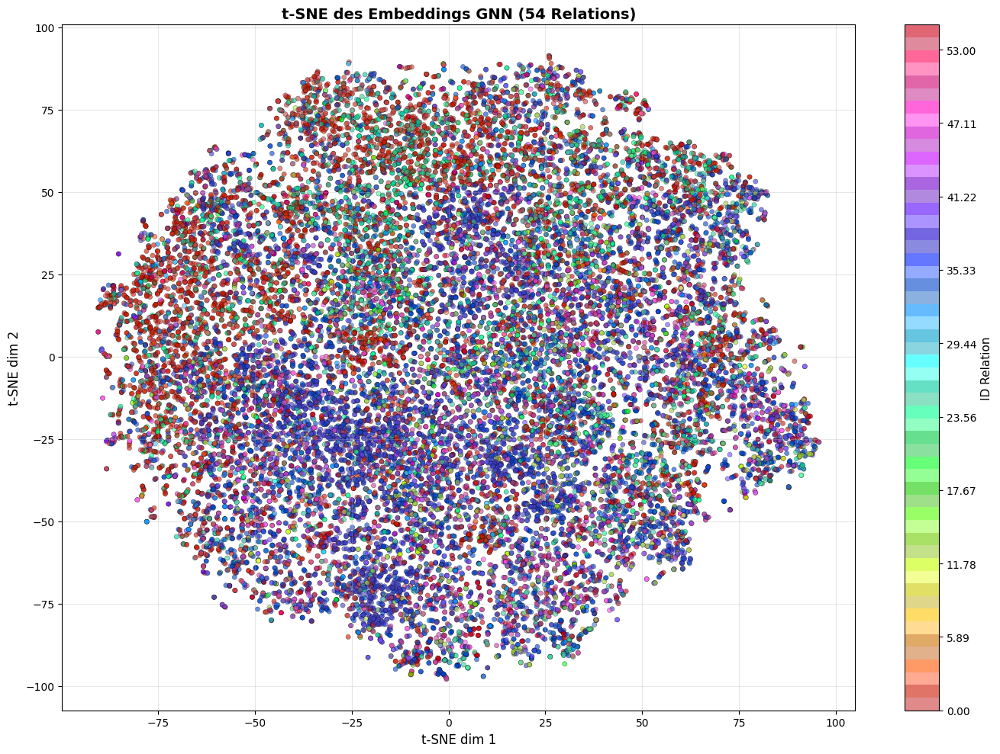

Visualisation sauvegardée : tsne_edge_embeddings_all.png
  - Points affichés : 26850
  - Relations uniques : 54



In [ ]:
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

print("\n=== Visualisation t-SNE des embeddings h ===")

sample_size = min(len(val_probe), len(val_probe))
indices = np.random.choice(len(val_probe), sample_size, replace=False)

embeddings = []
labels = []
for i in indices:
    emb, lbl, _, _, _, _, _, _ = val_probe[i]
    embeddings.append(emb.numpy())
    labels.append(lbl.item())

embeddings = np.array(embeddings)
labels = np.array(labels)

# t-SNE
print("Calcul t-SNE...")
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
embeddings_2d = tsne.fit_transform(embeddings)


n_classes = len(np.unique(labels))
print(f"Nombre de classes : {n_classes}")
import colorsys
def generate_distinct_colors(n):
    colors = []
    for i in range(n):
        hue = i / n  
        saturation = 0.7 + 0.3 * (i % 2) 
        value = 0.8 + 0.2 * ((i // 2) % 2)  
        rgb = colorsys.hsv_to_rgb(hue, saturation, value)
        colors.append(rgb)
    return colors
custom_colors = generate_distinct_colors(n_classes)
cmap = ListedColormap(custom_colors)
plt.figure(figsize=(14, 10))

scatter = plt.scatter(
    embeddings_2d[:, 0], 
    embeddings_2d[:, 1],
    c=labels,
    cmap=cmap,
    alpha=0.6,
    s=20,
    edgecolors='black',
    linewidth=0.3
)
plt.xlabel("t-SNE dim 1", fontsize=12)
plt.ylabel("t-SNE dim 2", fontsize=12)
plt.title(f"t-SNE des Embeddings GNN ({n_classes} Relations)", fontsize=14, fontweight='bold')
plt.grid(True, alpha=0.3)

cbar = plt.colorbar(scatter, ax=plt.gca(), ticks=np.linspace(0, n_classes-1, min(10, n_classes)))
cbar.set_label('ID Relation', fontsize=11)

plt.tight_layout()
plt.savefig("tsne_edge_embeddings_all.png", dpi=150, bbox_inches='tight')
plt.show()

print(f"Visualisation sauvegardée : tsne_edge_embeddings_all.png")
print(f"  - Points affichés : {len(embeddings_2d)}")
print(f"  - Relations uniques : {n_classes}\n")



=== Visualisation PCA des embeddings h ===
Calcul PCA...
Variance expliquée : PC1=15.65%, PC2=12.49%
Variance totale : 28.15%
Nombre de classes : 54


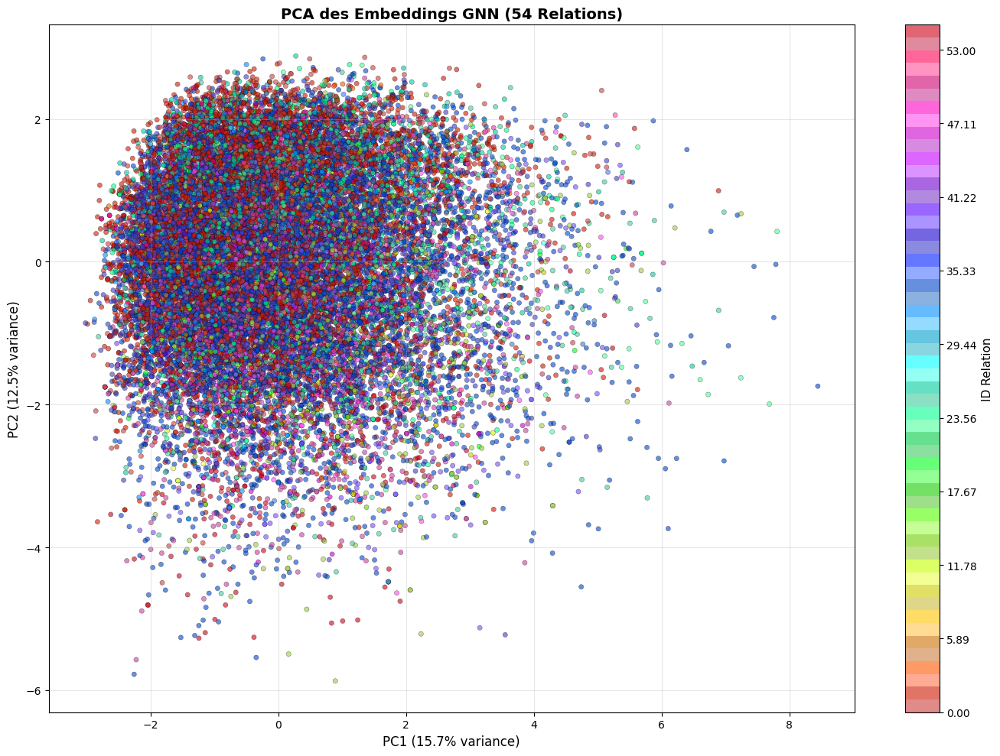

Visualisation sauvegardée : pca_edge_embeddings_all.png
  - Points affichés : 26850
  - Relations uniques : 54



In [ ]:
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import colorsys

print("\n=== Visualisation PCA des embeddings h ===")

sample_size = min(len(val_probe), len(val_probe))
indices = np.random.choice(len(val_probe), sample_size, replace=False)

embeddings = []
labels = []
for i in indices:
    emb, lbl, _, _, _, _, _, _ = val_probe[i]
    embeddings.append(emb.numpy())
    labels.append(lbl.item())

embeddings = np.array(embeddings)
labels = np.array(labels)

# PCA
print("Calcul PCA...")
pca = PCA(n_components=2, random_state=42)
embeddings_2d = pca.fit_transform(embeddings)

print(f"Variance expliquée : PC1={pca.explained_variance_ratio_[0]:.2%}, PC2={pca.explained_variance_ratio_[1]:.2%}")
print(f"Variance totale : {pca.explained_variance_ratio_.sum():.2%}")

n_classes = len(np.unique(labels))
print(f"Nombre de classes : {n_classes}")

custom_colors = generate_distinct_colors(n_classes)
cmap = ListedColormap(custom_colors)

plt.figure(figsize=(14, 10))

scatter = plt.scatter(
    embeddings_2d[:, 0], 
    embeddings_2d[:, 1],
    c=labels,
    cmap=cmap,
    alpha=0.6,
    s=20,
    edgecolors='black',
    linewidth=0.3
)

plt.xlabel(f"PC1 ({pca.explained_variance_ratio_[0]:.1%} variance)", fontsize=12)
plt.ylabel(f"PC2 ({pca.explained_variance_ratio_[1]:.1%} variance)", fontsize=12)
plt.title(f"PCA des Embeddings GNN ({n_classes} Relations)", fontsize=14, fontweight='bold')
plt.grid(True, alpha=0.3)

cbar = plt.colorbar(scatter, ax=plt.gca(), ticks=np.linspace(0, n_classes-1, min(10, n_classes)))
cbar.set_label('ID Relation', fontsize=11)

plt.tight_layout()
plt.savefig("pca_edge_embeddings_all.png", dpi=150, bbox_inches='tight')
plt.show()

print(f"Visualisation sauvegardée : pca_edge_embeddings_all.png")
print(f"  - Points affichés : {len(embeddings_2d)}")
print(f"  - Relations uniques : {n_classes}\n")


In [ ]:
sample_size = min(6000, len(val_probe)) 
indices = np.random.choice(len(val_probe), sample_size, replace=False)

embeddings = []
metadata = [] # relations

for i in indices:
    emb, lbl, _, _, _, _, _, _ = val_probe[i]
    embeddings.append(emb)
    metadata.append(IDX_TO_REL[lbl.item()])

embeddings_tensor = torch.stack(embeddings)
# envoyer a TensorBoard
writer.add_embedding(embeddings_tensor,
                     metadata=metadata,
                     tag="graph_Embeddings_Visualisation")
writer.close()

### 7.3 Entrainement du Linear Probe

[Epoch 1/12] Train Loss=2.6051 | Train Acc=0.297 || Val Loss=2.3341 | Val Acc=0.326
[Epoch 2/12] Train Loss=2.3064 | Train Acc=0.335 || Val Loss=2.2828 | Val Acc=0.334
[Epoch 3/12] Train Loss=2.2724 | Train Acc=0.340 || Val Loss=2.2630 | Val Acc=0.338
[Epoch 4/12] Train Loss=2.2554 | Train Acc=0.343 || Val Loss=2.2513 | Val Acc=0.341
[Epoch 5/12] Train Loss=2.2445 | Train Acc=0.344 || Val Loss=2.2448 | Val Acc=0.341
[Epoch 6/12] Train Loss=2.2365 | Train Acc=0.346 || Val Loss=2.2369 | Val Acc=0.343
[Epoch 7/12] Train Loss=2.2304 | Train Acc=0.347 || Val Loss=2.2326 | Val Acc=0.343
[Epoch 8/12] Train Loss=2.2255 | Train Acc=0.347 || Val Loss=2.2291 | Val Acc=0.345
[Epoch 9/12] Train Loss=2.2214 | Train Acc=0.348 || Val Loss=2.2249 | Val Acc=0.345
[Epoch 10/12] Train Loss=2.2178 | Train Acc=0.349 || Val Loss=2.2226 | Val Acc=0.346
[Epoch 11/12] Train Loss=2.2149 | Train Acc=0.349 || Val Loss=2.2201 | Val Acc=0.346
[Epoch 12/12] Train Loss=2.2121 | Train Acc=0.350 || Val Loss=2.2178 | Val

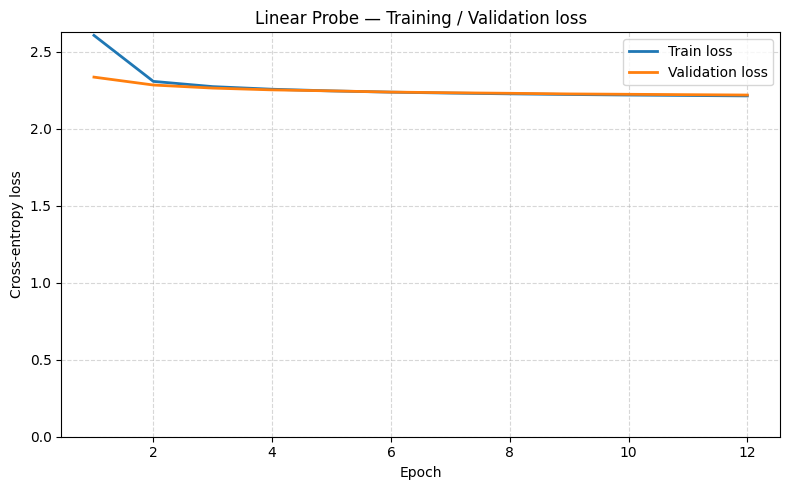

In [ ]:
# Linear Probe : simple couche linéaire sur les embeddings h gelés
import torch.nn as nn
import torch.nn.functional as F

emb_dim = next(iter(loader_train))[0].shape[1]
num_classes = len(REL_TO_IDX)

class LinearProbe(nn.Module):
    def __init__(self, in_dim, num_classes):
        super().__init__()
        self.fc = nn.Linear(in_dim, num_classes)

    def forward(self, x):
        return self.fc(x)

probe = LinearProbe(emb_dim, num_classes).to(DEVICE)
opt = torch.optim.Adam(probe.parameters(), lr=1e-3)
criterion = nn.CrossEntropyLoss()

EPOCHS = 12

train_losses = []
val_losses   = []

for epoch in range(EPOCHS):

    # ---------------------- TRAIN ----------------------
    probe.train()
    train_correct = 0
    train_total   = 0
    train_loss_sum = 0

    for batch in loader_train:
        xb, yb = batch[0].to(DEVICE), batch[1].to(DEVICE)

        logits = probe(xb)
        loss   = criterion(logits, yb)

        opt.zero_grad()
        loss.backward()
        opt.step()

        train_loss_sum += loss.item() * xb.size(0)
        train_correct  += (logits.argmax(1) == yb).sum().item()
        train_total    += xb.size(0)

    train_loss = train_loss_sum / train_total
    train_acc  = train_correct  / train_total

    # ---------------------- VAL ------------------------
    probe.eval()
    val_correct = 0
    val_total   = 0
    val_loss_sum = 0

    with torch.no_grad():
        for batch in loader_val:
            xb, yb = batch[0].to(DEVICE), batch[1].to(DEVICE)

            logits = probe(xb)
            loss   = criterion(logits, yb)

            val_loss_sum += loss.item() * xb.size(0)
            val_correct  += (logits.argmax(1) == yb).sum().item()
            val_total    += xb.size(0)

    val_loss = val_loss_sum / val_total
    val_acc  = val_correct  / val_total

    train_losses.append(train_loss)
    val_losses.append(val_loss)

    print(
        f"[Epoch {epoch+1}/{EPOCHS}] "
        f"Train Loss={train_loss:.4f} | Train Acc={train_acc:.3f} || "
        f"Val Loss={val_loss:.4f} | Val Acc={val_acc:.3f}"
    )

import matplotlib.pyplot as plt
import numpy as np

epochs = np.arange(1, EPOCHS + 1)

plt.figure(figsize=(8, 5))
plt.plot(
    epochs,
    train_losses,
    label="Train loss",
    color="tab:blue",
    linewidth=2
)
plt.plot(
    epochs,
    val_losses,
    label="Validation loss",
    color="tab:orange",
    linewidth=2
)
plt.xlabel("Epoch")
plt.ylabel("Cross-entropy loss")
plt.title("Linear Probe — Training / Validation loss")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.5)
plt.ylim(bottom=0.0)
plt.tight_layout()
plt.show()

### 7.4 Evaluation Top-K

             LINEAR PROBE - EVALUATION GLOBALE              

Total relations evaluees : 26850

Top-1 Accuracy : 34.7%
Top-3 Accuracy : 63.2%
Top-5 Accuracy : 76.4%


                    INFORMATIONS DATASET                    

Nombre de predicats supervises : 56
Exemples : about to hit, attached to, beside, biting, carrying, catching, chasing, cleaning, climbing, cooking


             EXEMPLES DE PREDICTIONS CORRECTES              



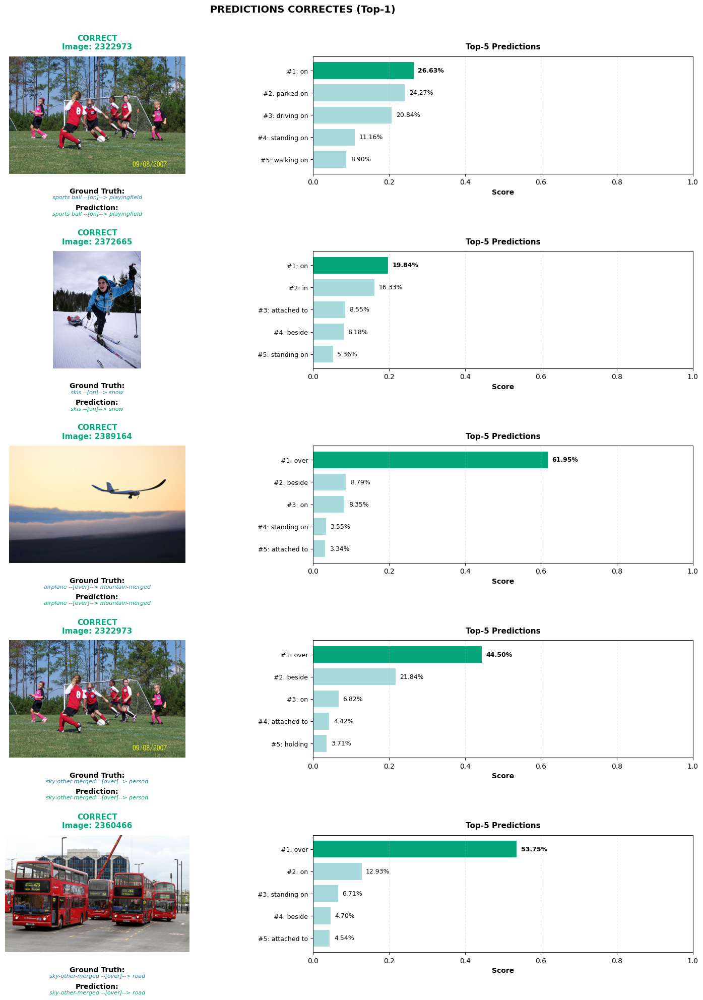


            EXEMPLES DE PREDICTIONS INCORRECTES             



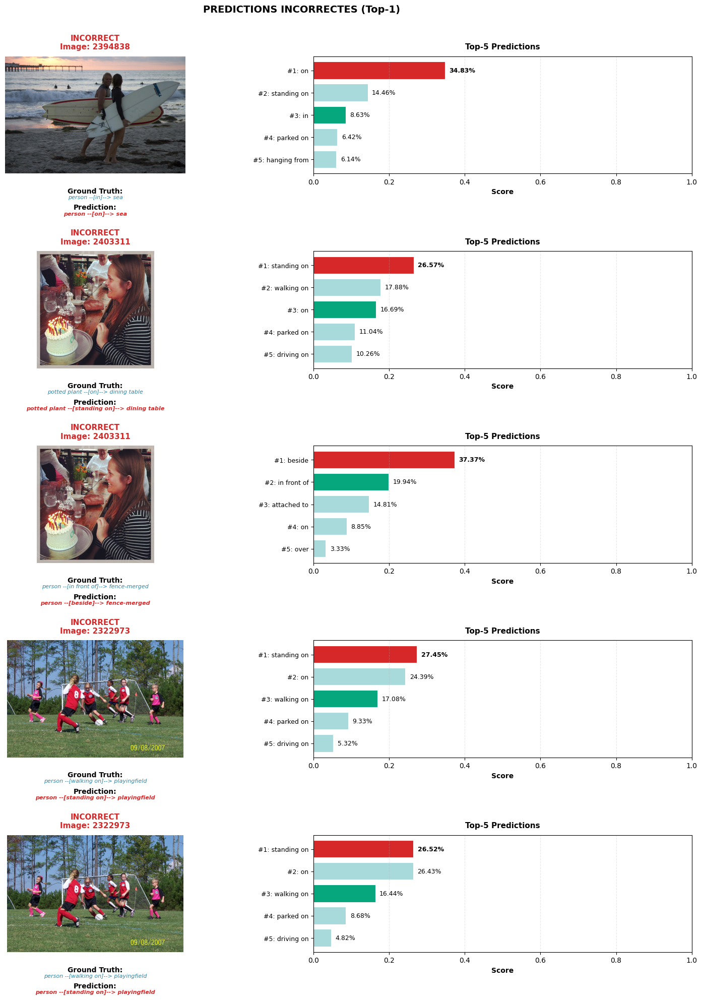


                      ANALYSE TERMINEE                      


In [ ]:
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle, FancyBboxPatch
from PIL import Image
import textwrap

DEVICE = torch.device("cpu")
probe.eval()
probe = probe.to(DEVICE)

# statistiques globales
correct_top1 = 0
correct_top3 = 0
correct_top5 = 0
total = 0

examples_correct = []
examples_incorrect = []

with torch.no_grad():
    for batch in loader_val:
        xb = batch[0].to(DEVICE)
        yb = batch[1].to(DEVICE)
        img_ids = batch[2]
        edge_idxs = batch[3]
        us = batch[4]
        vs = batch[5]
        segAs = batch[6]
        segBs = batch[7]

        logits = probe(xb)
        probs = F.softmax(logits, dim=1)

        top5 = torch.topk(probs, k=5, dim=1).indices
        top5_probs = torch.topk(probs, k=5, dim=1).values

        for i in range(xb.size(0)):
            gt = yb[i].item()
            total += 1

            pred_top1 = top5[i, 0].item()
            is_correct = (pred_top1 == gt)

            if is_correct:
                correct_top1 += 1
            if gt in top5[i, :3].tolist():
                correct_top3 += 1
            if gt in top5[i, :5].tolist():
                correct_top5 += 1

            example = {
                'img_id': img_ids[i],
                'edge_idx': edge_idxs[i].item(),
                'u': us[i].item(),
                'v': vs[i].item(),
                'segA': segAs[i],
                'segB': segBs[i],
                'gt_label': gt,
                'gt_name': IDX_TO_REL[gt],
                'pred_label': pred_top1,
                'pred_name': IDX_TO_REL[pred_top1],
                'top5_labels': top5[i].cpu().tolist(),
                'top5_names': [IDX_TO_REL[idx] for idx in top5[i].cpu().tolist()],
                'top5_probs': top5_probs[i].cpu().tolist(),
                'is_correct': is_correct
            }

            if is_correct and len(examples_correct) < 20:
                examples_correct.append(example)
            elif not is_correct and len(examples_incorrect) < 20:
                examples_incorrect.append(example)

acc1 = correct_top1 / total
acc3 = correct_top3 / total
acc5 = correct_top5 / total

print("="*60)
print("LINEAR PROBE - EVALUATION GLOBALE".center(60))
print("="*60)
print(f"\nTotal relations evaluees : {total}")
print(f"\nTop-1 Accuracy : {acc1:.1%}")
print(f"Top-3 Accuracy : {acc3:.1%}")
print(f"Top-5 Accuracy : {acc5:.1%}")
print("\n" + "="*60 + "\n")

print("="*60)
print("INFORMATIONS DATASET".center(60))
print("="*60)
print(f"\nNombre de predicats supervises : {len(REL_TO_IDX)}")
print(f"Exemples : {', '.join(list(REL_TO_IDX.keys())[:10])}")
print("\n" + "="*60 + "\n")

def get_objects_info(img_id, segA, segB):
    """Récupère les informations des objets A et B depuis le scene graph"""
    img_id = str(img_id)
    segA = int(segA)
    segB = int(segB)
    if img_id in scene_val:
        scene = scene_val[img_id]
    elif img_id in scene_train:
        scene = scene_train[img_id]
    else:
        return None, None
    obj_A = None
    obj_B = None
    for obj in scene['objects']:
        if obj['segment_id'] == segA:
            obj_A = obj
        if obj['segment_id'] == segB:
            obj_B = obj
    return obj_A, obj_B

def visualize_prediction(example, ax_img, ax_bar):
    img_id = example['img_id']
    img = None
    if img_id in imageid_to_path_val:
        path = imageid_to_path_val[img_id]
    elif img_id in imageid_to_path_train:
        path = imageid_to_path_train[img_id]
    else:
        path = None
    
    if path and path.exists():
        try:
            img = np.array(Image.open(path).convert("RGB"))
        except:
            img = None
    
    obj_A, obj_B = get_objects_info(img_id, example['segA'], example['segB'])
    

    if img is not None:
        ax_img.imshow(img)
        img_height, img_width = img.shape[:2]
        
        if obj_A and 'bbox' in obj_A:
            bbox_A = obj_A['bbox'] 
            rect_A = FancyBboxPatch(
                (bbox_A[0], bbox_A[1]), bbox_A[2], bbox_A[3],
                linewidth=3, edgecolor='#FF6B6B', facecolor='none',
                linestyle='-', boxstyle="round,pad=3"
            )
            ax_img.add_patch(rect_A)
            
            ax_img.text(bbox_A[0], bbox_A[1] - 5,
                       f"SUBJECT: {obj_A['name']}", 
                       fontsize=9, fontweight='bold',
                       color='white', 
                       bbox=dict(boxstyle='round,pad=0.4', 
                                facecolor='#FF6B6B', alpha=0.9, edgecolor='none'),
                       va='bottom')
        
        if obj_B and 'bbox' in obj_B:
            bbox_B = obj_B['bbox'] 
            rect_B = FancyBboxPatch(
                (bbox_B[0], bbox_B[1]), bbox_B[2], bbox_B[3],
                linewidth=3, edgecolor='#4ECDC4', facecolor='none',
                linestyle='-', boxstyle="round,pad=3"
            )
            ax_img.add_patch(rect_B)
            
            ax_img.text(bbox_B[0], bbox_B[1] - 5,
                       f"OBJECT: {obj_B['name']}", 
                       fontsize=9, fontweight='bold',
                       color='white',
                       bbox=dict(boxstyle='round,pad=0.4', 
                                facecolor='#4ECDC4', alpha=0.9, edgecolor='none'),
                       va='bottom')
    else:
        ax_img.imshow(np.ones((100, 100, 3), dtype=np.uint8) * 200)
    
    ax_img.axis('off')
    
    is_correct = example['is_correct']
    color = '#06A77D' if is_correct else '#D62828'
    status = "CORRECT" if is_correct else "INCORRECT"
    
    title_text = f"{status}\nImage: {img_id}"
    ax_img.set_title(title_text, fontsize=11, fontweight='bold', color=color, pad=10)

    text_y = -0.12
    
    if obj_A and obj_B:
        triplet_gt = f"{obj_A['name']} --[{example['gt_name']}]--> {obj_B['name']}"
        triplet_pred = f"{obj_A['name']} --[{example['pred_name']}]--> {obj_B['name']}"
    else:
        triplet_gt = example['gt_name']
        triplet_pred = example['pred_name']
    
    ax_img.text(0.5, text_y, "Ground Truth:", transform=ax_img.transAxes,
                fontsize=10, fontweight='bold', ha='center', va='top')
    text_y -= 0.06
    ax_img.text(0.5, text_y, triplet_gt, transform=ax_img.transAxes,
                fontsize=8, ha='center', va='top', color='#2E86AB',
                style='italic')
    
    text_y -= 0.08
    ax_img.text(0.5, text_y, "Prediction:", transform=ax_img.transAxes,
                fontsize=10, fontweight='bold', ha='center', va='top')
    text_y -= 0.06
    pred_color = '#06A77D' if is_correct else '#D62828'
    ax_img.text(0.5, text_y, triplet_pred, transform=ax_img.transAxes,
                fontsize=8, ha='center', va='top', color=pred_color,
                style='italic', weight='bold' if not is_correct else 'normal')
    
    y_positions = np.arange(5)
    colors_bar = []
    
    for i, (name, prob, label) in enumerate(zip(example['top5_names'], 
                                                  example['top5_probs'],
                                                  example['top5_labels'])):
        if label == example['gt_label']:
            colors_bar.append('#06A77D')
        elif i == 0:
            colors_bar.append('#D62828' if not is_correct else '#2E86AB')
        else:
            colors_bar.append('#A8DADC')
    
    bars = ax_bar.barh(y_positions, example['top5_probs'], color=colors_bar, 
                       edgecolor='white', linewidth=1.5)
    
    ax_bar.set_yticks(y_positions)
    ax_bar.set_yticklabels([f"#{i+1}: {name[:20]}" for i, name in enumerate(example['top5_names'])],
                           fontsize=9)
    ax_bar.set_xlabel('Score', fontsize=10, fontweight='bold')
    ax_bar.set_title('Top-5 Predictions', fontsize=11, fontweight='bold', pad=10)
    ax_bar.set_xlim(0, 1.0)
    ax_bar.grid(axis='x', alpha=0.3, linestyle='--')
    
    for i, (bar, prob) in enumerate(zip(bars, example['top5_probs'])):
        width = bar.get_width()
        ax_bar.text(width + 0.01, bar.get_y() + bar.get_height()/2,
                   f'{prob:.2%}', ha='left', va='center', fontsize=9,
                   fontweight='bold' if i == 0 else 'normal')
    
    ax_bar.invert_yaxis()

def plot_prediction_examples(examples, title, n_examples=3):
    n_examples = min(n_examples, len(examples))
    
    if n_examples == 0:
        print(f"Aucun exemple disponible pour : {title}")
        return
    
    fig = plt.figure(figsize=(16, 4 * n_examples))
    fig.suptitle(title, fontsize=14, fontweight='bold', y=0.995)
    
    for i in range(n_examples):
        ax_img = plt.subplot(n_examples, 2, 2*i + 1)
        ax_bar = plt.subplot(n_examples, 2, 2*i + 2)
        visualize_prediction(examples[i], ax_img, ax_bar)
    
    plt.tight_layout(rect=[0, 0, 1, 0.99])
    plt.show()

np.random.seed(42)
n_show = 5
print("="*60)
print("EXEMPLES DE PREDICTIONS CORRECTES".center(60))
print("="*60 + "\n")

if len(examples_correct) > 0:
    selected_correct = np.random.choice(len(examples_correct), 
                                       size=min(n_show, len(examples_correct)), 
                                       replace=False)
    plot_prediction_examples([examples_correct[i] for i in selected_correct],
                           "PREDICTIONS CORRECTES (Top-1)", n_examples=n_show)
else:
    print("Aucun exemple correct trouve.\n")

print("\n" + "="*60)
print("EXEMPLES DE PREDICTIONS INCORRECTES".center(60))
print("="*60 + "\n")

if len(examples_incorrect) > 0:
    selected_incorrect = np.random.choice(len(examples_incorrect),
                                         size=min(n_show, len(examples_incorrect)),
                                         replace=False)
    plot_prediction_examples([examples_incorrect[i] for i in selected_incorrect],
                           "PREDICTIONS INCORRECTES (Top-1)", n_examples=n_show)
else:
    print("Aucun exemple incorrect trouve (Accuracy = 100% !)\n")

print("\n" + "="*60)
print("ANALYSE TERMINEE".center(60))
print("="*60)


### 7.5 Analyse de la distribution des classes

STATISTIQUES DE DISTRIBUTION DES LABELS
Nombre total de classes : 56
Nombre d'échantillons train : 215679
Nombre d'échantillons val : 26850

Most Frequent Class Baseline (Top-1) : 0.187
  -> Classe : 'on'
  -> Occurrences : 40437

Random Baseline:
  Top-1 : 0.018 (1.79%)
  Top-3 : 0.054 (5.36%)
  Top-5 : 0.089 (8.93%)

TOP-10 CLASSES LES PLUS FRÉQUENTES (TRAIN)
------------------------------------------------------------
 1. on                   : 40437 (18.75%)
 2. beside               : 36820 (17.07%)
 3. over                 : 31954 (14.82%)
 4. attached to          : 16941 ( 7.85%)
 5. standing on          : 14843 ( 6.88%)
 6. in front of          :  9146 ( 4.24%)
 7. in                   :  7496 ( 3.48%)
 8. holding              :  7323 ( 3.40%)
 9. parked on            :  5920 ( 2.74%)
10. walking on           :  5786 ( 2.68%)

BOTTOM-10 CLASSES LES MOINS FRÉQUENTES (TRAIN)
------------------------------------------------------------
 1. falling off          :     4 ( 0.00%)
 2. 

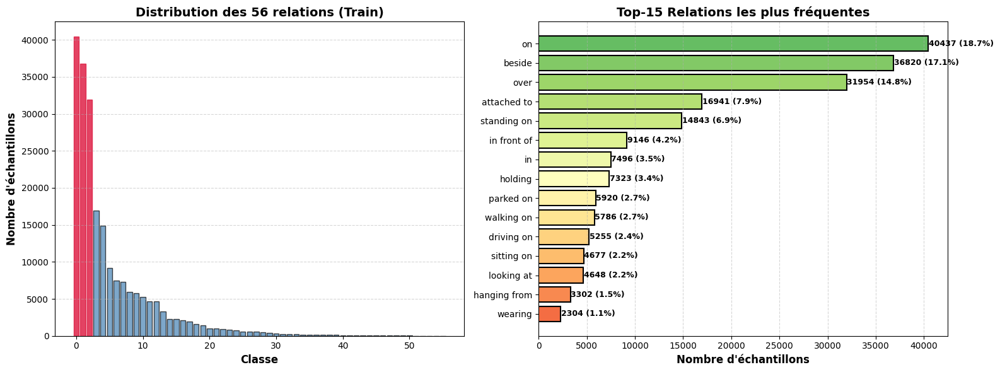

In [141]:
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter
import torch

labels_train = [lbl for _, lbl, *_ in train_probe.samples]
labels_val = [lbl for _, lbl, *_ in val_probe.samples]

train_counts = Counter(labels_train)
val_counts = Counter(labels_val)

print("=" * 60)
print("STATISTIQUES DE DISTRIBUTION DES LABELS")
print("=" * 60)
print(f"Nombre total de classes : {len(REL_TO_IDX)}")
print(f"Nombre d'échantillons train : {len(labels_train)}")
print(f"Nombre d'échantillons val : {len(labels_val)}")
print()

most_frequent_train = train_counts.most_common(1)[0]
most_frequent_acc = most_frequent_train[1] / len(labels_train)
print(f"Most Frequent Class Baseline (Top-1) : {most_frequent_acc:.3f}")
print(f"  -> Classe : '{IDX_TO_REL[most_frequent_train[0]]}'")
print(f"  -> Occurrences : {most_frequent_train[1]}")
print()

random_top1 = 1 / len(REL_TO_IDX)
random_top3 = 3 / len(REL_TO_IDX)
random_top5 = 5 / len(REL_TO_IDX)
print(f"Random Baseline:")
print(f"  Top-1 : {random_top1:.3f} ({random_top1*100:.2f}%)")
print(f"  Top-3 : {random_top3:.3f} ({random_top3*100:.2f}%)")
print(f"  Top-5 : {random_top5:.3f} ({random_top5*100:.2f}%)")
print("=" * 60)

print("\nTOP-10 CLASSES LES PLUS FRÉQUENTES (TRAIN)")
print("-" * 60)
for i, (idx, count) in enumerate(train_counts.most_common(10), 1):
    pct = count / len(labels_train) * 100
    print(f"{i:2d}. {IDX_TO_REL[idx]:20s} : {count:5d} ({pct:5.2f}%)")

print("\nBOTTOM-10 CLASSES LES MOINS FRÉQUENTES (TRAIN)")
print("-" * 60)
for i, (idx, count) in enumerate(train_counts.most_common()[-10:][::-1], 1):
    pct = count / len(labels_train) * 100
    print(f"{i:2d}. {IDX_TO_REL[idx]:20s} : {count:5d} ({pct:5.2f}%)")

fig = plt.figure(figsize=(16, 6))

ax1 = plt.subplot(1, 2, 1)
sorted_counts = sorted(train_counts.values(), reverse=True)
x_pos = np.arange(len(sorted_counts))

bars = ax1.bar(x_pos, sorted_counts, color='steelblue', alpha=0.7, edgecolor='black')

# Colorer les top-3 en rouge
for i in range(min(3, len(bars))):
    bars[i].set_color('crimson')
    bars[i].set_alpha(0.8)

ax1.set_xlabel('Classe', fontsize=12, fontweight='bold')
ax1.set_ylabel('Nombre d\'échantillons', fontsize=12, fontweight='bold')
ax1.set_title('Distribution des 56 relations (Train)', fontsize=14, fontweight='bold')
ax1.grid(axis='y', linestyle='--', alpha=0.5)

ax2 = plt.subplot(1, 2, 2)
top_15 = train_counts.most_common(15)
labels_top15 = [IDX_TO_REL[idx] for idx, _ in top_15]
counts_top15 = [count for _, count in top_15]
colors_top15 = plt.cm.RdYlGn_r(np.linspace(0.2, 0.8, len(labels_top15)))

bars2 = ax2.barh(np.arange(len(labels_top15)), counts_top15, color=colors_top15, 
                 edgecolor='black', linewidth=1.5)

for i, (bar, count) in enumerate(zip(bars2, counts_top15)):
    pct = count / len(labels_train) * 100
    ax2.text(count + 50, i, f'{count} ({pct:.1f}%)', 
             va='center', fontsize=9, fontweight='bold')

ax2.set_yticks(np.arange(len(labels_top15)))
ax2.set_yticklabels(labels_top15, fontsize=10)
ax2.invert_yaxis()
ax2.set_xlabel('Nombre d\'échantillons', fontsize=12, fontweight='bold')
ax2.set_title('Top-15 Relations les plus fréquentes', fontsize=14, fontweight='bold')
ax2.grid(axis='x', linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()


### 7.6 Metriques detaillees avec desequilibre

Collecte des prédictions sur le validation set...
Total prédictions : 26850

MÉTRIQUES GLOBALES
Accuracy (micro-averaged) : 0.3468

MACRO-AVERAGED (traite toutes les classes également):
  Precision : 0.0980
  Recall    : 0.0466
  F1-Score  : 0.0442

WEIGHTED-AVERAGED (pondéré par fréquence des classes):
  Precision : 0.2788
  Recall    : 0.3468
  F1-Score  : 0.2642

ANALYSE PAR FRÉQUENCE DE CLASSE

Très fréquent (>1000) (7 classes):
  Nombre d'échantillons : 19815
  Accuracy : 0.4592

Fréquent (500-1000) (6 classes):
  Nombre d'échantillons : 4129
  Accuracy : 0.0446

Moyen (100-500) (11 classes):
  Nombre d'échantillons : 2236
  Accuracy : 0.0107

Rare (10-100) (18 classes):
  Nombre d'échantillons : 610
  Accuracy : 0.0049

Très rare (<10) (14 classes):
  Nombre d'échantillons : 60
  Accuracy : 0.0167

PERFORMANCE PAR CLASSE

TOP-10 CLASSES (meilleures performances F1):
----------------------------------------------------------------------
Rang  Relation             Prec     Recall  

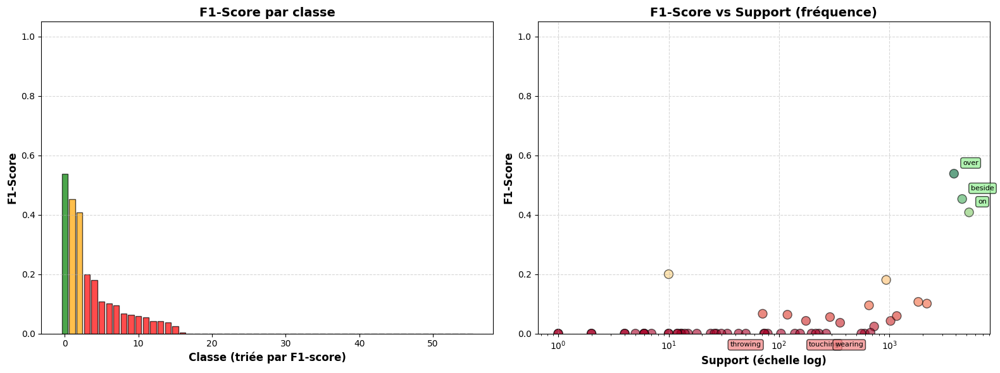


MATRICE DE CONFUSION (TOP-10 CLASSES)


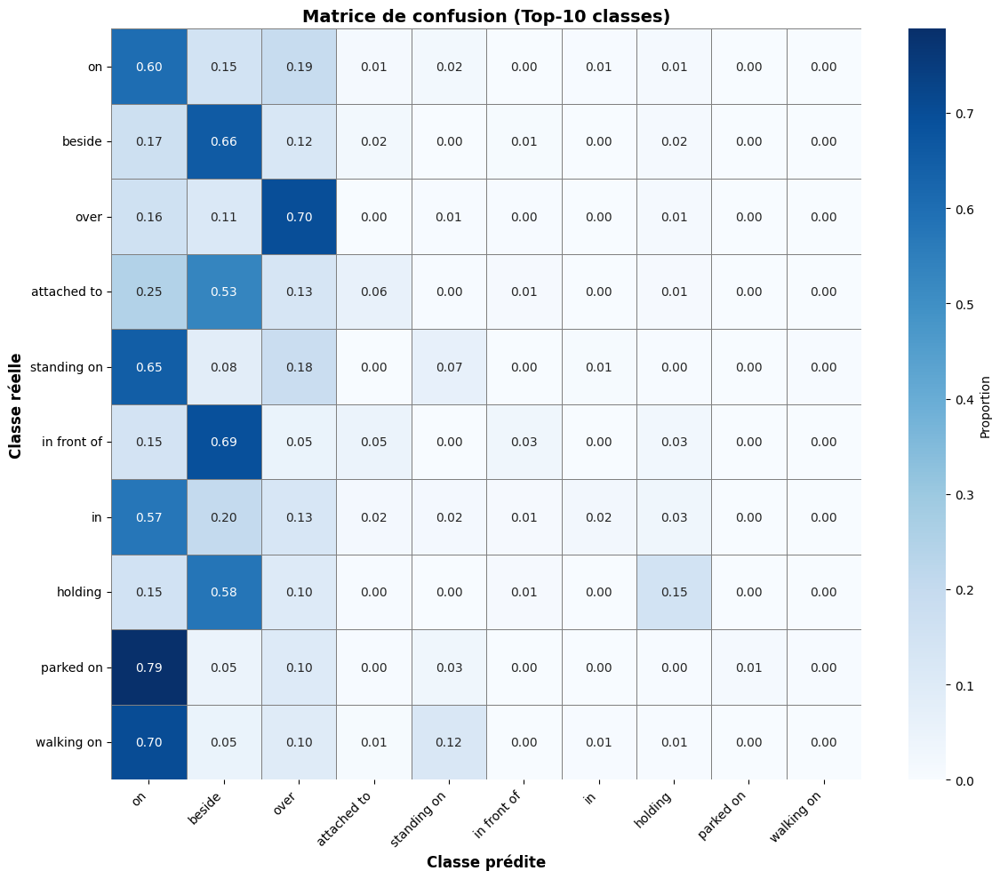


Nombre d'échantillons dans le Top-10 : 22143 / 26850 (82.5%)


In [ ]:
import numpy as np
import torch
import torch.nn.functional as F
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, accuracy_score
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict

print("Collecte des prédictions sur le validation set...")
all_preds = []
all_labels = []
all_probs = []

probe.eval()
with torch.no_grad():
    for batch in loader_val:
        xb = batch[0].to(DEVICE)
        yb = batch[1].to(DEVICE)
        
        logits = probe(xb)
        probs = F.softmax(logits, dim=1)
        preds = logits.argmax(1)
        
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(yb.cpu().numpy())
        all_probs.append(probs.cpu().numpy())

all_preds = np.array(all_preds)
all_labels = np.array(all_labels)
all_probs = np.vstack(all_probs)
print(f"Total prédictions : {len(all_preds)}")
print()
print("=" * 70)
print("MÉTRIQUES GLOBALES")
print("=" * 70)
accuracy = accuracy_score(all_labels, all_preds)
print(f"Accuracy (micro-averaged) : {accuracy:.4f}")
print()
all_class_labels = list(range(len(REL_TO_IDX)))
precision_macro, recall_macro, f1_macro, _ = precision_recall_fscore_support(
    all_labels, all_preds, average='macro', labels=all_class_labels, zero_division=0
)
precision_weighted, recall_weighted, f1_weighted, _ = precision_recall_fscore_support(
    all_labels, all_preds, average='weighted', labels=all_class_labels, zero_division=0
)

print("MACRO-AVERAGED (traite toutes les classes également):")
print(f"  Precision : {precision_macro:.4f}")
print(f"  Recall    : {recall_macro:.4f}")
print(f"  F1-Score  : {f1_macro:.4f}")
print()
print("WEIGHTED-AVERAGED (pondéré par fréquence des classes):")
print(f"  Precision : {precision_weighted:.4f}")
print(f"  Recall    : {recall_weighted:.4f}")
print(f"  F1-Score  : {f1_weighted:.4f}")
print()
print("=" * 70)
print("ANALYSE PAR FRÉQUENCE DE CLASSE")
print("=" * 70)
val_counts = {i: np.sum(all_labels == i) for i in range(len(REL_TO_IDX))}
freq_bins = {
    'Très fréquent (>1000)': [],
    'Fréquent (500-1000)': [],
    'Moyen (100-500)': [],
    'Rare (10-100)': [],
    'Très rare (<10)': []
}
for idx, count in val_counts.items():
    if count > 1000:
        freq_bins['Très fréquent (>1000)'].append(idx)
    elif count >= 500:
        freq_bins['Fréquent (500-1000)'].append(idx)
    elif count >= 100:
        freq_bins['Moyen (100-500)'].append(idx)
    elif count >= 10:
        freq_bins['Rare (10-100)'].append(idx)
    else:
        freq_bins['Très rare (<10)'].append(idx)

for bin_name, class_indices in freq_bins.items():
    if len(class_indices) == 0:
        continue
    mask = np.isin(all_labels, class_indices)
    if mask.sum() == 0:
        continue
    
    labels_subset = all_labels[mask]
    preds_subset = all_preds[mask]
    
    acc_subset = accuracy_score(labels_subset, preds_subset)
    
    print(f"\n{bin_name} ({len(class_indices)} classes):")
    print(f"  Nombre d'échantillons : {mask.sum()}")
    print(f"  Accuracy : {acc_subset:.4f}")

print()
print("=" * 70)
print("PERFORMANCE PAR CLASSE")
print("=" * 70)


precision_per_class, recall_per_class, f1_per_class, support_per_class = \
    precision_recall_fscore_support(all_labels, all_preds, labels=all_class_labels, 
                                   average=None, zero_division=0)
class_metrics = []
for i in range(len(REL_TO_IDX)):
    class_metrics.append({
        'idx': i,
        'name': IDX_TO_REL[i],
        'precision': precision_per_class[i],
        'recall': recall_per_class[i],
        'f1': f1_per_class[i],
        'support_val': support_per_class[i],
        'support_train': train_counts.get(i, 0)
    })

class_metrics_sorted = sorted(class_metrics, key=lambda x: x['f1'], reverse=True)
print("\nTOP-10 CLASSES (meilleures performances F1):")
print("-" * 70)
print(f"{'Rang':<5} {'Relation':<20} {'Prec':<8} {'Recall':<8} {'F1':<8} {'Support':<10}")
print("-" * 70)
for i, m in enumerate(class_metrics_sorted[:10], 1):
    print(f"{i:<5} {m['name']:<20} {m['precision']:<8.3f} {m['recall']:<8.3f} "
          f"{m['f1']:<8.3f} {int(m['support_val']):<10}")
print("\nBOTTOM-10 CLASSES (pires performances F1):")
print("-" * 70)
print(f"{'Rang':<5} {'Relation':<20} {'Prec':<8} {'Recall':<8} {'F1':<8} {'Support':<10}")
print("-" * 70)
for i, m in enumerate(class_metrics_sorted[-10:][::-1], 1):
    print(f"{i:<5} {m['name']:<20} {m['precision']:<8.3f} {m['recall']:<8.3f} "
          f"{m['f1']:<8.3f} {int(m['support_val']):<10}")
print("\n" + "=" * 70)
print("CLASSES JAMAIS PRÉDITES")
print("=" * 70)

pred_counts = {i: np.sum(all_preds == i) for i in range(len(REL_TO_IDX))}
never_predicted = [i for i in range(len(REL_TO_IDX)) if pred_counts[i] == 0]

if len(never_predicted) > 0:
    print(f"\nNombre de classes jamais prédites : {len(never_predicted)} / {len(REL_TO_IDX)}")
    print("\nListe des classes jamais prédites :")
    for idx in never_predicted:
        print(f"  - {IDX_TO_REL[idx]:<20} (support val: {int(support_per_class[idx])})")
else:
    print("\nToutes les classes ont été prédites au moins une fois.")

fig, axes = plt.subplots(1, 2, figsize=(16, 6))
ax1 = axes[0]
f1_sorted = sorted(f1_per_class, reverse=True)
colors = ['green' if f1 > 0.5 else 'orange' if f1 > 0.2 else 'red' for f1 in f1_sorted]
ax1.bar(range(len(f1_sorted)), f1_sorted, color=colors, alpha=0.7, edgecolor='black')
ax1.set_xlabel('Classe (triée par F1-score)', fontsize=12, fontweight='bold')
ax1.set_ylabel('F1-Score', fontsize=12, fontweight='bold')
ax1.set_title('F1-Score par classe', fontsize=14, fontweight='bold')
ax1.grid(axis='y', linestyle='--', alpha=0.5)
ax1.set_ylim([0, 1.05])

ax2 = axes[1]
supports = [val_counts.get(i, 0) + 1 for i in range(len(REL_TO_IDX))]
ax2.scatter(supports, f1_per_class, alpha=0.6, s=100, c=f1_per_class, 
            cmap='RdYlGn', edgecolors='black', linewidth=1)
ax2.set_xscale('log')
ax2.set_xlabel('Support (échelle log)', fontsize=12, fontweight='bold')
ax2.set_ylabel('F1-Score', fontsize=12, fontweight='bold')
ax2.set_title('F1-Score vs Support (fréquence)', fontsize=14, fontweight='bold')
ax2.grid(True, linestyle='--', alpha=0.5)
ax2.set_ylim([0, 1.05])

for m in class_metrics_sorted[:3]:
    idx = m['idx']
    if val_counts.get(idx, 0) > 0:
        ax2.annotate(m['name'], (val_counts.get(idx, 0) + 1, f1_per_class[idx]),
                    xytext=(10, 10), textcoords='offset points', fontsize=8,
                    bbox=dict(boxstyle='round', facecolor='lightgreen', alpha=0.7))

for m in class_metrics_sorted[-3:]:
    idx = m['idx']
    if val_counts.get(idx, 0) > 0:
        ax2.annotate(m['name'], (val_counts.get(idx, 0) + 1, f1_per_class[idx]),
                    xytext=(10, -15), textcoords='offset points', fontsize=8,
                    bbox=dict(boxstyle='round', facecolor='lightcoral', alpha=0.7))

plt.tight_layout()
plt.show()

print("\n" + "=" * 70)
print("MATRICE DE CONFUSION (TOP-10 CLASSES)")
print("=" * 70)

top_10_indices = [idx for idx, _ in train_counts.most_common(10)]
top_10_names = [IDX_TO_REL[idx] for idx in top_10_indices]

mask_top10 = np.isin(all_labels, top_10_indices)
labels_top10 = all_labels[mask_top10]
preds_top10 = all_preds[mask_top10]

label_mapping = {old_idx: new_idx for new_idx, old_idx in enumerate(top_10_indices)}
labels_top10_mapped = np.array([label_mapping.get(l, -1) for l in labels_top10])
preds_top10_mapped = np.array([label_mapping.get(p, -1) for p in preds_top10])

cm = confusion_matrix(labels_top10_mapped, preds_top10_mapped, labels=range(10))
cm_normalized = cm.astype('float') / (cm.sum(axis=1)[:, np.newaxis] + 1e-10)

fig, ax = plt.subplots(figsize=(12, 10))
sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Blues', 
            xticklabels=top_10_names, yticklabels=top_10_names,
            cbar_kws={'label': 'Proportion'}, ax=ax, linewidths=0.5, linecolor='gray')
ax.set_xlabel('Classe prédite', fontsize=12, fontweight='bold')
ax.set_ylabel('Classe réelle', fontsize=12, fontweight='bold')
ax.set_title('Matrice de confusion (Top-10 classes)', fontsize=14, fontweight='bold')
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()


print(f"\nNombre d'échantillons dans le Top-10 : {mask_top10.sum()} / {len(all_labels)} ({mask_top10.sum()/len(all_labels)*100:.1f}%)")

# accuracy micro averaged = 0.34 -> proportion totale de prédictions correctes. 
# Macro averaged -> traite toutes les classes de manière égale indépendamment de leur fréquence.
# Weighted averaged -> pondere chaque classe par son nombre d'échantillons (support).

---
## 8. Analyse PCA des Embeddings

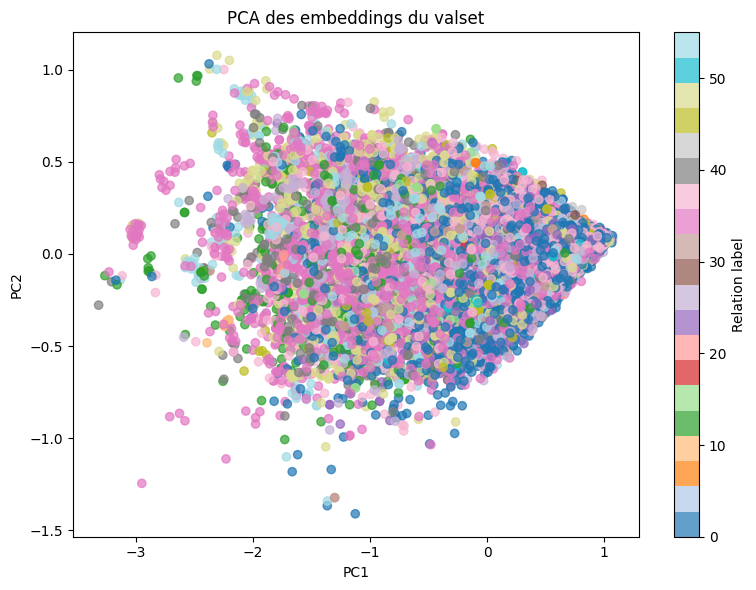

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np

embeddings = []
labels = []
for i in range(len(val_probe)):
    emb, lbl, *_ = val_probe[i]
    embeddings.append(emb.numpy())
    labels.append(lbl.item())

embeddings = np.stack(embeddings)
labels = np.array(labels)

# PCA
pca = PCA(n_components=2)
emb_2d = pca.fit_transform(embeddings)

plt.figure(figsize=(8, 6))
scatter = plt.scatter(emb_2d[:, 0], emb_2d[:, 1], c=labels, cmap='tab20', alpha=0.7)
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('PCA des embeddings du valset')
plt.colorbar(scatter, label='Relation label')
plt.tight_layout()
plt.show()

---
## 9. Content-Based Image Retrieval (CBIR)

### 9.2 Evaluation qualitative du retrieval

Extraction des embeddings pour le retrieval...


Encoding graphs: 100%|██████████| 4787/4787 [00:07<00:00, 662.80it/s]


Shape des embeddings : (4787, 128)

ANALYSE DES CAS EXTREME

Calcul des similarités moyennes pour tous les graphes...


Computing similarities: 100%|██████████| 4787/4787 [00:08<00:00, 534.92it/s]



Meilleur cas trouvé:
  Index: 1979, Similarité moyenne top-5: 0.9889

Pire cas trouvé:
  Index: 2939, Similarité moyenne top-5: 0.8868

EXEMPLES DE RETRIEVAL QUALITATIF

EXEMPLES ALÉATOIRES

EXEMPLE ALÉATOIRE 1/3


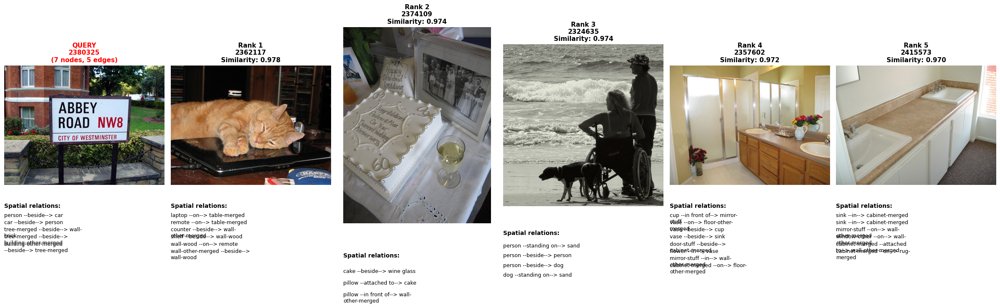


Query: 2380325
  Nodes: 7, Edges: 5
  Spatial relations: 5

Top-5 Retrieved:
  1. 2362117 (sim=0.978, nodes=8, edges=7, spatial_rels=6)
  2. 2374109 (sim=0.974, nodes=4, edges=3, spatial_rels=3)
  3. 2324635 (sim=0.974, nodes=5, edges=4, spatial_rels=4)
  4. 2357602 (sim=0.972, nodes=12, edges=8, spatial_rels=8)
  5. 2415573 (sim=0.970, nodes=7, edges=6, spatial_rels=6)

Similarité moyenne top-5: 0.9739

EXEMPLE ALÉATOIRE 2/3


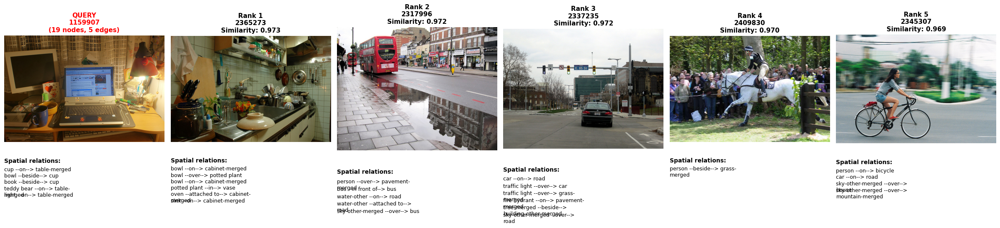


Query: 1159907
  Nodes: 19, Edges: 5
  Spatial relations: 5

Top-5 Retrieved:
  1. 2365273 (sim=0.973, nodes=31, edges=7, spatial_rels=6)
  2. 2317996 (sim=0.972, nodes=19, edges=8, spatial_rels=5)
  3. 2337235 (sim=0.972, nodes=24, edges=7, spatial_rels=6)
  4. 2409830 (sim=0.970, nodes=18, edges=7, spatial_rels=1)
  5. 2345307 (sim=0.969, nodes=16, edges=8, spatial_rels=4)

Similarité moyenne top-5: 0.9711

EXEMPLE ALÉATOIRE 3/3


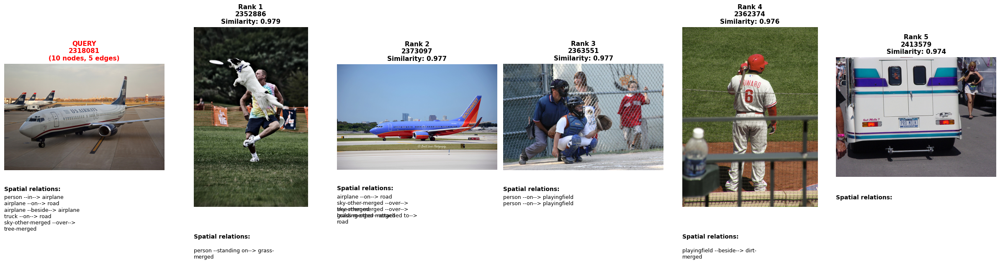


Query: 2318081
  Nodes: 10, Edges: 5
  Spatial relations: 5

Top-5 Retrieved:
  1. 2352886 (sim=0.979, nodes=8, edges=3, spatial_rels=1)
  2. 2373097 (sim=0.977, nodes=7, edges=4, spatial_rels=4)
  3. 2363551 (sim=0.977, nodes=10, edges=5, spatial_rels=2)
  4. 2362374 (sim=0.976, nodes=6, edges=3, spatial_rels=1)
  5. 2413579 (sim=0.974, nodes=9, edges=5, spatial_rels=0)

Similarité moyenne top-5: 0.9764

MEILLEUR CAS DE RETRIEVAL

Graphe avec la plus haute similarité moyenne avec ses voisins


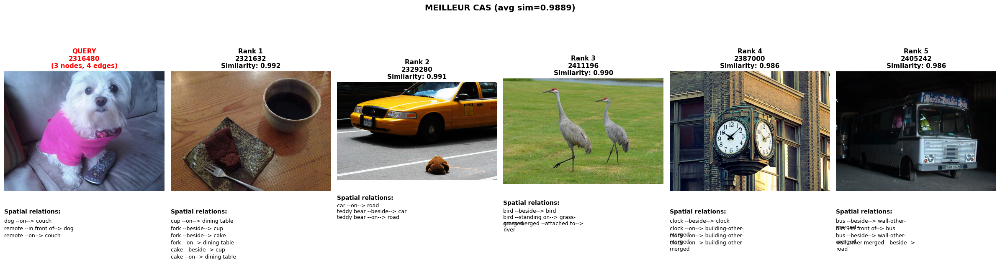


Query: 2316480
  Nodes: 3, Edges: 4
  Spatial relations: 3

Top-5 Retrieved:
  1. 2321632 (sim=0.992, nodes=5, edges=6, spatial_rels=6)
  2. 2329280 (sim=0.991, nodes=3, edges=5, spatial_rels=3)
  3. 2411196 (sim=0.990, nodes=4, edges=4, spatial_rels=3)
  4. 2387000 (sim=0.986, nodes=3, edges=4, spatial_rels=4)
  5. 2405242 (sim=0.986, nodes=6, edges=6, spatial_rels=4)

PIRE CAS DE RETRIEVAL

Graphe avec la plus faible similarité moyenne avec ses voisins


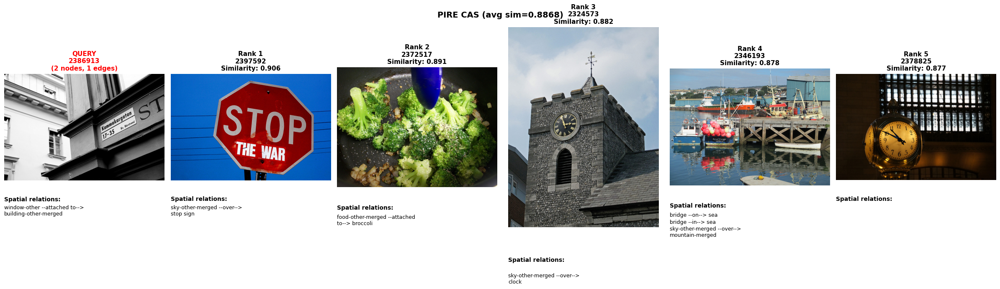


Query: 2386913
  Nodes: 2, Edges: 1
  Spatial relations: 1

Top-5 Retrieved:
  1. 2397592 (sim=0.906, nodes=2, edges=1, spatial_rels=1)
  2. 2372517 (sim=0.891, nodes=7, edges=1, spatial_rels=1)
  3. 2324573 (sim=0.882, nodes=3, edges=1, spatial_rels=1)
  4. 2346193 (sim=0.878, nodes=10, edges=3, spatial_rels=3)
  5. 2378825 (sim=0.877, nodes=5, edges=1, spatial_rels=0)

STATISTIQUES GLOBALES DE RETRIEVAL

Distribution des similarités moyennes top-5:
  Mean:   0.9679
  Median: 0.9705
  Std:    0.0120
  Min:    0.8868
  Max:    0.9889


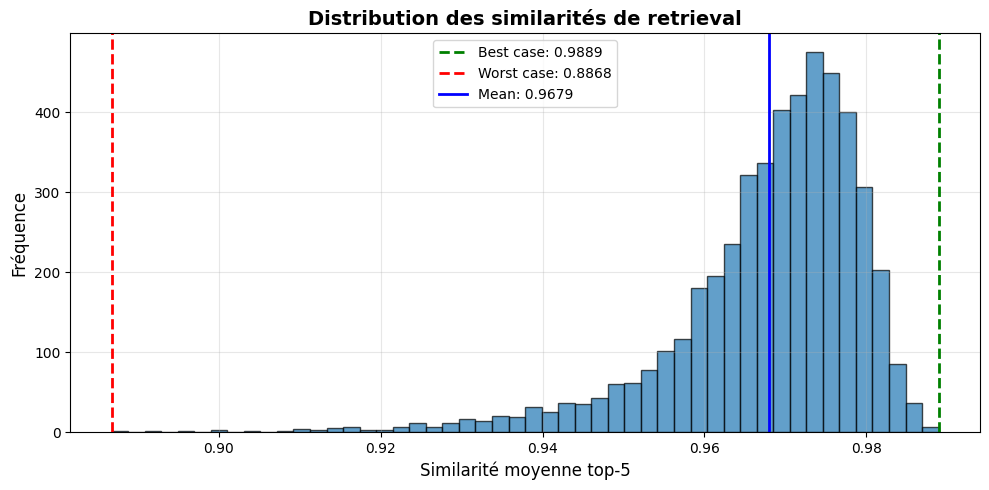


ANALYSE TERMINÉE


In [142]:
import numpy as np
import matplotlib.pyplot as plt
import textwrap
from sklearn.metrics.pairwise import cosine_similarity
from PIL import Image
from collections import defaultdict

print("Extraction des embeddings pour le retrieval...")

graph_embeddings = []
graph_metadata = []

model.eval()
with torch.no_grad():
    for g in tqdm(val_dataset, desc="Encoding graphs"):
        h_graph = model.get_graph_embedding(g.to(DEVICE)).cpu().numpy()
        
        if h_graph.ndim > 1:
            h_graph = h_graph.flatten()
        
        graph_embeddings.append(h_graph)
        graph_metadata.append({
            'img_id': str(g.img_id),
            'num_nodes': g.x.shape[0],
            'num_edges': g.edge_index.shape[1]
        })

graph_embeddings = np.array(graph_embeddings)
print(f"Shape des embeddings : {graph_embeddings.shape}")
print()

def load_rgb_from_img_id(img_id):
    img_id = str(img_id)
    if img_id in imageid_to_path_val:
        path = imageid_to_path_val[img_id]
    elif img_id in imageid_to_path_train:
        path = imageid_to_path_train[img_id]
    else:
        return None
    try:
        return np.array(Image.open(path).convert("RGB"))
    except:
        return None

def get_relations_text(img_id):
    img_id = str(img_id)
    if img_id in scene_val:
        scene = scene_val[img_id]
    elif img_id in scene_train:
        scene = scene_train[img_id]
    else:
        return []
    objs = {o["segment_id"]: o["name"] for o in scene["objects"]}
    rels_txt = []
    for r in scene["relations"]:
        s = objs.get(r["subject_id"], str(r["subject_id"]))
        o = objs.get(r["object_id"], str(r["object_id"]))
        p = r["predicate"]
        rels_txt.append(f"{s} --{p}--> {o}")
    return rels_txt

def get_spatial_relations_only(img_id):
    spatial_predicates = {'on', 'beside', 'over', 'in', 'in front of', 'behind',
                          'under', 'attached to', 'standing on'}
    img_id = str(img_id)
    if img_id in scene_val:
        scene = scene_val[img_id]
    elif img_id in scene_train:
        scene = scene_train[img_id]
    else:
        return []

    spatial_rels = []
    objs = {o["segment_id"]: o["name"] for o in scene["objects"]}
    for r in scene["relations"]:
        if r["predicate"] in spatial_predicates:
            s = objs.get(r["subject_id"], str(r["subject_id"]))
            o = objs.get(r["object_id"], str(r["object_id"]))
            p = r["predicate"]
            spatial_rels.append(f"{s} --{p}--> {o}")
    return spatial_rels

def retrieve_similar_graphs(query_idx, top_k=5):
    """Retrieve top-k graphes similaires"""
    query_emb = graph_embeddings[query_idx].reshape(1, -1)
    # similarités cosinus
    similarities = cosine_similarity(query_emb, graph_embeddings)[0]

    similarities[query_idx] = -np.inf
    # Top-K 
    top_k_indices = np.argsort(similarities)[::-1][:top_k]
    top_k_scores = similarities[top_k_indices]

    return top_k_indices, top_k_scores

def visualize_retrieval(query_idx, top_k=5, title_prefix=""):
    """Affiche query + top-k résultats"""
    top_k_indices, top_k_scores = retrieve_similar_graphs(query_idx, top_k)

    query_meta = graph_metadata[query_idx]
    query_img_id = query_meta['img_id']
    query_img = load_rgb_from_img_id(query_img_id)
    query_rels = get_spatial_relations_only(query_img_id)

    ncols = top_k + 1
    fig = plt.figure(figsize=(4 * ncols, 6))

    if title_prefix:
        fig.suptitle(title_prefix, fontsize=14, fontweight='bold', y=0.98)

    ax = plt.subplot(1, ncols, 1)
    if query_img is not None:
        ax.imshow(query_img)
    ax.axis("off")
    ax.set_title(f"QUERY\n{query_img_id}\n({query_meta['num_nodes']} nodes, {query_meta['num_edges']} edges)",
                 fontsize=11, fontweight='bold', color='red')

    ytxt = -0.15
    ax.text(0.0, ytxt, "Spatial relations:", transform=ax.transAxes,
            fontsize=10, fontweight='bold', va='top')
    ytxt -= 0.08
    for rel in query_rels[:8]:
        ax.text(0.0, ytxt, textwrap.fill(rel, 30), transform=ax.transAxes,
                fontsize=9, va='top')
        ytxt -= 0.06

    for i, (idx, score) in enumerate(zip(top_k_indices, top_k_scores), start=2):
        meta = graph_metadata[idx]
        img_id = meta['img_id']
        img = load_rgb_from_img_id(img_id)
        rels = get_spatial_relations_only(img_id)

        ax = plt.subplot(1, ncols, i)
        if img is not None:
            ax.imshow(img)
        ax.axis("off")
        ax.set_title(f"Rank {i-1}\n{img_id}\nSimilarity: {score:.3f}",
                     fontsize=11, fontweight='bold')

        ytxt = -0.15
        ax.text(0.0, ytxt, "Spatial relations:", transform=ax.transAxes,
                fontsize=10, fontweight='bold', va='top')
        ytxt -= 0.08
        for rel in rels[:8]:
            ax.text(0.0, ytxt, textwrap.fill(rel, 30), transform=ax.transAxes,
                    fontsize=9, va='top')
            ytxt -= 0.06

    plt.tight_layout()
    plt.show()

    print(f"\nQuery: {query_img_id}")
    print(f"  Nodes: {query_meta['num_nodes']}, Edges: {query_meta['num_edges']}")
    print(f"  Spatial relations: {len(query_rels)}")
    print(f"\nTop-{top_k} Retrieved:")
    for rank, (idx, score) in enumerate(zip(top_k_indices, top_k_scores), 1):
        meta = graph_metadata[idx]
        rels = get_spatial_relations_only(meta['img_id'])
        print(f"  {rank}. {meta['img_id']} (sim={score:.3f}, nodes={meta['num_nodes']}, "
              f"edges={meta['num_edges']}, spatial_rels={len(rels)})")

    return np.mean(top_k_scores)

print("=" * 70)
print("ANALYSE DES CAS EXTREME")
print("=" * 70)
print("\nCalcul des similarités moyennes pour tous les graphes...")

mean_similarities = []
for i in tqdm(range(len(graph_embeddings)), desc="Computing similarities"):
    _, scores = retrieve_similar_graphs(i, top_k=5)
    mean_sim = np.mean(scores)
    mean_similarities.append(mean_sim)

mean_similarities = np.array(mean_similarities)

best_idx = np.argmax(mean_similarities)
worst_idx = np.argmin(mean_similarities)

print(f"\nMeilleur cas trouvé:")
print(f"  Index: {best_idx}, Similarité moyenne top-5: {mean_similarities[best_idx]:.4f}")
print(f"\nPire cas trouvé:")
print(f"  Index: {worst_idx}, Similarité moyenne top-5: {mean_similarities[worst_idx]:.4f}")

print("\n" + "=" * 70)
print("EXEMPLES DE RETRIEVAL QUALITATIF")
print("=" * 70)
print()

print("=" * 70)
print("EXEMPLES ALÉATOIRES")
print("=" * 70)
np.random.seed(42)
query_indices = np.random.choice(len(graph_embeddings), size=3, replace=False)

for i, query_idx in enumerate(query_indices, 1):
    print(f"\n{'='*70}")
    print(f"EXEMPLE ALÉATOIRE {i}/3")
    print(f"{'='*70}")
    avg_sim = visualize_retrieval(query_idx, top_k=5)
    print(f"\nSimilarité moyenne top-5: {avg_sim:.4f}")

print("\n" + "=" * 70)
print("MEILLEUR CAS DE RETRIEVAL")
print("=" * 70)
print(f"\nGraphe avec la plus haute similarité moyenne avec ses voisins")
visualize_retrieval(best_idx, top_k=5,
                   title_prefix=f"MEILLEUR CAS (avg sim={mean_similarities[best_idx]:.4f})")

print("\n" + "=" * 70)
print("PIRE CAS DE RETRIEVAL")
print("=" * 70)
print(f"\nGraphe avec la plus faible similarité moyenne avec ses voisins")
visualize_retrieval(worst_idx, top_k=5,
                   title_prefix=f"PIRE CAS (avg sim={mean_similarities[worst_idx]:.4f})")

print("\n" + "=" * 70)
print("STATISTIQUES GLOBALES DE RETRIEVAL")
print("=" * 70)
print(f"\nDistribution des similarités moyennes top-5:")
print(f"  Mean:   {np.mean(mean_similarities):.4f}")
print(f"  Median: {np.median(mean_similarities):.4f}")
print(f"  Std:    {np.std(mean_similarities):.4f}")
print(f"  Min:    {np.min(mean_similarities):.4f}")
print(f"  Max:    {np.max(mean_similarities):.4f}")

plt.figure(figsize=(10, 5))
plt.hist(mean_similarities, bins=50, edgecolor='black', alpha=0.7)
plt.axvline(mean_similarities[best_idx], color='green', linestyle='--',
            linewidth=2, label=f'Best case: {mean_similarities[best_idx]:.4f}')
plt.axvline(mean_similarities[worst_idx], color='red', linestyle='--',
            linewidth=2, label=f'Worst case: {mean_similarities[worst_idx]:.4f}')
plt.axvline(np.mean(mean_similarities), color='blue', linestyle='-',
            linewidth=2, label=f'Mean: {np.mean(mean_similarities):.4f}')
plt.xlabel('Similarité moyenne top-5', fontsize=12)
plt.ylabel('Fréquence', fontsize=12)
plt.title('Distribution des similarités de retrieval', fontsize=14, fontweight='bold')
plt.legend()
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

print("\n" + "=" * 70)
print("ANALYSE TERMINÉE")
print("=" * 70)


---
## 10. Alignement Multimodal Image-Graphe

Fusion entre representations visuelles (ResNet) et structurelles (GNN).

### 10.1 Preparation du cache

In [38]:
# AVANT de relancer
CACHE_TRAIN.unlink(missing_ok=True)
CACHE_VAL.unlink(missing_ok=True)


NameError: name 'CACHE_TRAIN' is not defined

In [110]:
from torch.utils.tensorboard import SummaryWriter
import io
from PIL import Image

log_dir = "runs/multimodal_alignment"
writer = SummaryWriter(log_dir)

print(f"TensorBoard logging dans: {log_dir}")
print(f"Lancer avec: tensorboard --logdir={log_dir}\n")


TensorBoard logging dans: runs/multimodal_alignment
Lancer avec: tensorboard --logdir=runs/multimodal_alignment



### 10.3 Utilitaires de visualisation

In [ ]:
def plot_to_tensor(figure):
    buf = io.BytesIO()
    figure.savefig(buf, format='png', dpi=150, bbox_inches='tight')
    buf.seek(0)
    
    image = Image.open(buf)
    image = transforms.ToTensor()(image)
    
    plt.close(figure)
    buf.close()
    
    return image


### 10.4 Entrainement de l'alignement multimodal

c:\envs\env_gnn\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\envs\env_gnn\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet-50 charge et gele

GNN gele (embeddings graph-level)

Construction du dataset multimodal (premiere fois)...


Encoding images + graphs: 100%|██████████| 38258/38258 [21:56<00:00, 29.05it/s]


Cache sauvegarde : C:\Users\yassi\Desktop\MSI_Project\multimodal_cache\embeddings_train.pt
38258 paires creees

Construction du dataset multimodal (premiere fois)...


Encoding images + graphs: 100%|██████████| 4787/4787 [02:36<00:00, 30.67it/s]


Cache sauvegarde : C:\Users\yassi\Desktop\MSI_Project\multimodal_cache\embeddings_val.pt
4787 paires creees

Train: 38258 samples
Val: 4787 samples

=== ENTRAINEMENT ALIGNEMENT MULTIMODAL ===



Epoch 1/10: 100%|██████████| 150/150 [00:02<00:00, 58.89it/s]


Epoch 01 | Train: 5.0953 | Val: 4.8794


Epoch 2/10: 100%|██████████| 150/150 [00:02<00:00, 58.60it/s]


Epoch 02 | Train: 4.8604 | Val: 4.8057


Epoch 3/10: 100%|██████████| 150/150 [00:02<00:00, 65.25it/s]


Epoch 03 | Train: 4.7666 | Val: 4.7567


Epoch 4/10: 100%|██████████| 150/150 [00:02<00:00, 64.82it/s]


Epoch 04 | Train: 4.6951 | Val: 4.7426


Epoch 5/10: 100%|██████████| 150/150 [00:02<00:00, 64.23it/s]


Epoch 05 | Train: 4.6241 | Val: 4.7032


Epoch 6/10: 100%|██████████| 150/150 [00:02<00:00, 63.02it/s]


Epoch 06 | Train: 4.5741 | Val: 4.7095


Epoch 7/10: 100%|██████████| 150/150 [00:02<00:00, 64.05it/s]


Epoch 07 | Train: 4.5158 | Val: 4.7057


Epoch 8/10: 100%|██████████| 150/150 [00:02<00:00, 64.34it/s]


Epoch 08 | Train: 4.4647 | Val: 4.6827


Epoch 9/10: 100%|██████████| 150/150 [00:02<00:00, 65.50it/s]


Epoch 09 | Train: 4.4221 | Val: 4.7023


Epoch 10/10: 100%|██████████| 150/150 [00:02<00:00, 63.80it/s]


Epoch 10 | Train: 4.3650 | Val: 4.7052

Projector sauvegarde : multimodal_projector.pth


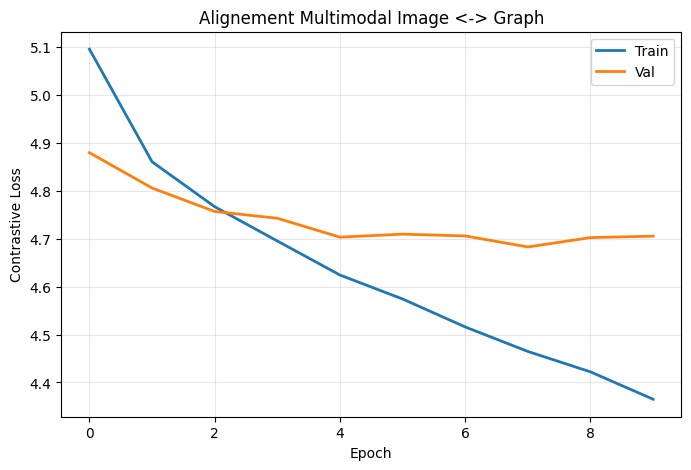

Courbes sauvegardees : multimodal_alignment_loss.png


In [ ]:
# ================================================================
# ALIGNEMENT MULTIMODAL : IMAGE RGB <-> GRAPH
# ================================================================

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
from pathlib import Path
from tqdm import tqdm
import matplotlib.pyplot as plt


# Encoder d'images ResNet-50 pré-entraîné gelé
resnet = models.resnet50(pretrained=True)
resnet.fc = nn.Identity()
resnet = resnet.to(DEVICE)
resnet.eval()

for param in resnet.parameters():
    param.requires_grad = False

print("ResNet-50 charge et gele\n")

preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

def encode_image_resnet(image_path, device):
    """Embedding ResNet-50 d'une image (2048 dim)"""
    image = Image.open(image_path).convert('RGB')
    image_tensor = preprocess(image).unsqueeze(0).to(device)
    
    with torch.no_grad():
        img_emb = resnet(image_tensor)
    return img_emb.squeeze(0)

# Encoder graph GNN gelé
model.eval()
for param in model.parameters():
    param.requires_grad = False

print("GNN gele\n")


class MultimodalAlignmentDataset(Dataset):
    def __init__(self, pyg_dataset, imageid_to_path, gnn_model, device, cache_path):
        self.device = device
        self.cache_path = Path(cache_path)
        
        if self.cache_path.exists():
            print(f"Chargement du cache : {self.cache_path}")
            self.samples = torch.load(self.cache_path, weights_only=False)
            print(f"{len(self.samples)} paires chargees depuis le cache\n")
        else:
            print(f"Construction du dataset multimodal...")
            self.samples = []
            
            for graph in tqdm(pyg_dataset, desc="Encoding images + graphs"):
                img_id = str(graph.img_id)
                img_path = imageid_to_path.get(img_id)
                
                if img_path is None or not img_path.exists():
                    continue
                img_emb = encode_image_resnet(img_path, device)
                
                with torch.no_grad():
                    graph_emb = gnn_model.get_graph_embedding(graph.to(device))
                
                if img_emb.dim() > 1:
                    img_emb = img_emb.squeeze()
                if graph_emb.dim() > 1:
                    graph_emb = graph_emb.squeeze()
                
                self.samples.append((img_emb.cpu(), graph_emb.cpu(), img_id))
            
            self.cache_path.parent.mkdir(parents=True, exist_ok=True)
            torch.save(self.samples, self.cache_path)
            print(f"Cache sauvegarde : {self.cache_path}")
            print(f"{len(self.samples)} paires creees\n")
    
    def __len__(self):
        return len(self.samples)
    
    def __getitem__(self, idx):
        img_emb, graph_emb, img_id = self.samples[idx]
        return img_emb, graph_emb, img_id


class MultimodalProjector(nn.Module):
    def __init__(self, emb_dim_img=2048, emb_dim_graph=128, proj_dim=256):
        super().__init__()
        
        self.proj_img = nn.Sequential(
            nn.Linear(2048, 1024),
            nn.BatchNorm1d(1024), 
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(1024, 512),
            nn.BatchNorm1d(512),  
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, 256)
        )

        self.proj_graph = nn.Sequential(
            nn.Linear(128, 256),
            nn.BatchNorm1d(256),  
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(256, 256),
            nn.BatchNorm1d(256),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(256, 256)
        )

    
    def forward(self, img_emb, graph_emb):
        if img_emb.dim() == 3:
            img_emb = img_emb.squeeze(1)
        if graph_emb.dim() == 3:
            graph_emb = graph_emb.squeeze(1)
        
        z_img = self.proj_img(img_emb)
        z_graph = self.proj_graph(graph_emb)
        
        z_img = F.normalize(z_img, dim=-1)
        z_graph = F.normalize(z_graph, dim=-1)
    
        return z_img, z_graph


# Loss contrastive multimodale
def multimodal_contrastive_loss(z_img, z_graph, temperature=0.2):
    """
    InfoNCE bidirectionnel : image->graph + graph->image
    """
    #print(f"DEBUG - z_img shape: {z_img.shape}, z_graph shape: {z_graph.shape}")
    if z_img.size(0) > z_img.size(1):
        z_img = z_img.transpose(0, 1)
    if z_graph.size(0) > z_graph.size(1):
        z_graph = z_graph.transpose(0, 1)
    
    #print(f"z_img shape: {z_img.shape}, z_graph shape: {z_graph.shape}")
    batch_size = z_img.size(0)
    logits = torch.matmul(z_img, z_graph.transpose(0, 1)) / temperature
    #print(f"logits shape: {logits.shape}")
    labels = torch.arange(batch_size, device=z_img.device)
    # Loss symetrique
    loss_i2g = F.cross_entropy(logits, labels)
    loss_g2i = F.cross_entropy(logits.transpose(0, 1), labels)
    return (loss_i2g + loss_g2i) / 2


CACHE_DIR = Path("C:/Users/yassi/Desktop/MSI_Project/multimodal_cache")
CACHE_TRAIN = CACHE_DIR / "embeddings_train.pt"
CACHE_VAL = CACHE_DIR / "embeddings_val.pt"

train_dataset_pyg = PSGDataset(TRAIN_ROOT, TRAIN_JSON)
multimodal_train = MultimodalAlignmentDataset(
    pyg_dataset=train_dataset_pyg,
    imageid_to_path=imageid_to_path_train,
    gnn_model=model,
    device=DEVICE,
    cache_path=CACHE_TRAIN
)

val_dataset_pyg = PSGDataset(VAL_ROOT, VAL_JSON)
multimodal_val = MultimodalAlignmentDataset(
    pyg_dataset=val_dataset_pyg,
    imageid_to_path=imageid_to_path_val,
    gnn_model=model,
    device=DEVICE,
    cache_path=CACHE_VAL
)

loader_multimodal_train = DataLoader(multimodal_train, batch_size=256, shuffle=True)
loader_multimodal_val = DataLoader(multimodal_val, batch_size=256, shuffle=False)

print(f"Train: {len(multimodal_train)} samples")
print(f"Val: {len(multimodal_val)} samples\n")

# Entrainement du projector multimodal
projector = MultimodalProjector(
    emb_dim_img=2048,
    emb_dim_graph=128,
    proj_dim=256
).to(DEVICE)

optimizer = torch.optim.Adam(projector.parameters(), lr=1e-3, weight_decay=1e-4)

EPOCHS_MULTIMODAL = 10
train_losses_mm = []
val_losses_mm = []

print("=== ENTRAINEMENT ALIGNEMENT MULTIMODAL ===\n")

for epoch in range(EPOCHS_MULTIMODAL):
    
    projector.train()
    total_train = 0.0
    
    for img_emb, graph_emb, _ in tqdm(loader_multimodal_train, desc=f"Epoch {epoch+1}/{EPOCHS_MULTIMODAL}"):
        img_emb = img_emb.to(DEVICE)
        graph_emb = graph_emb.to(DEVICE)
        
        z_img, z_graph = projector(img_emb, graph_emb)
        loss = multimodal_contrastive_loss(z_img, z_graph)
        
        optimizer.zero_grad()
        loss.backward()
        torch.nn.utils.clip_grad_norm_(projector.parameters(), max_norm=1.0)
        optimizer.step()
        
        total_train += loss.item()
    
    avg_train = total_train / len(loader_multimodal_train)
    train_losses_mm.append(avg_train)
    
    projector.eval()
    total_val = 0.0
    
    with torch.no_grad():
        for img_emb, graph_emb, _ in loader_multimodal_val:
            img_emb = img_emb.to(DEVICE)
            graph_emb = graph_emb.to(DEVICE)
            
            z_img, z_graph = projector(img_emb, graph_emb)
            loss = multimodal_contrastive_loss(z_img, z_graph)
            total_val += loss.item()
    
    avg_val = total_val / len(loader_multimodal_val)
    val_losses_mm.append(avg_val)
    
    print(f"Epoch {epoch+1:02d} | Train: {avg_train:.4f} | Val: {avg_val:.4f}")

torch.save(projector.state_dict(), "multimodal_projector.pth")
print("\nProjector sauvegarde : multimodal_projector.pth")


plt.figure(figsize=(8, 5))
plt.plot(train_losses_mm, label='Train', linewidth=2, color='tab:blue')
plt.plot(val_losses_mm, label='Val', linewidth=2, color='tab:orange')
plt.xlabel('Epoch')
plt.ylabel('Contrastive Loss')
plt.title('Alignement Multimodal Image <-> Graph')
plt.legend()
plt.grid(True, alpha=0.3)
plt.savefig('multimodal_alignment_loss.png')
plt.show()

print("Courbes sauvegardees : multimodal_alignment_loss.png")


### 10.5 Visualisation t-SNE de l'espace aligne

=== t-SNE de l'espace multimodal aligne ===

Calcul t-SNE...


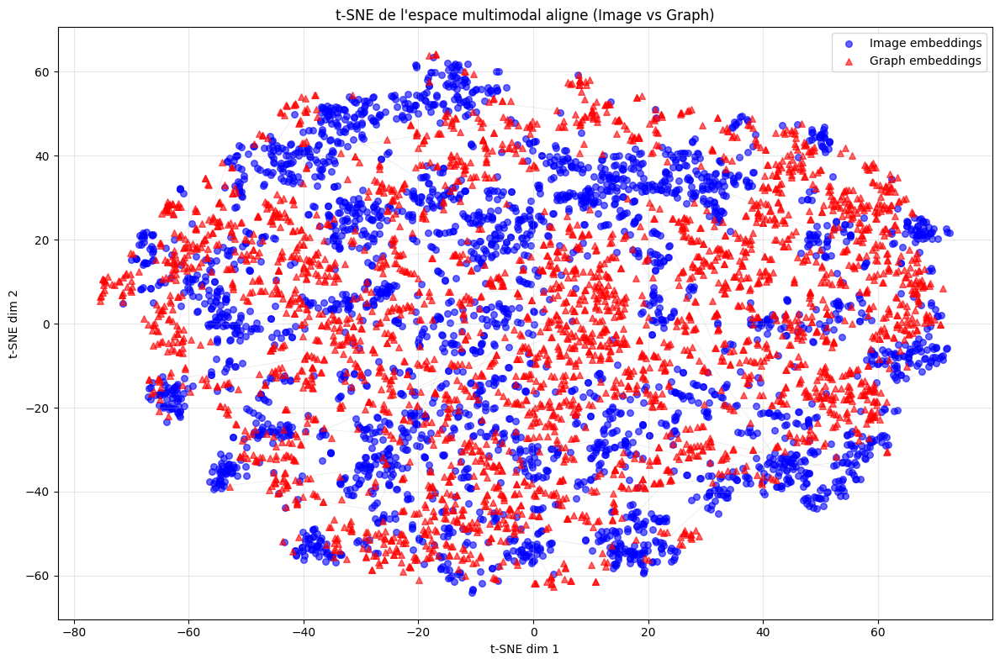

Visualisation sauvegardee : tsne_multimodal_alignment.png



In [ ]:
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

print("=== t-SNE de l'espace multimodal aligne ===\n")

projector.eval()

sample_size = min(3000, len(multimodal_val))
indices = np.random.choice(len(multimodal_val), sample_size, replace=False)

z_imgs = []
z_graphs = []

with torch.no_grad():
    for i in indices:
        img_emb, graph_emb, img_id = multimodal_val[i]
        img_emb = img_emb.unsqueeze(0).to(DEVICE)
        graph_emb = graph_emb.unsqueeze(0).to(DEVICE)
        
        z_img, z_graph = projector(img_emb, graph_emb)
        
        z_imgs.append(z_img.cpu().numpy())
        z_graphs.append(z_graph.cpu().numpy())

z_imgs = np.vstack(z_imgs)
z_graphs = np.vstack(z_graphs)

all_embeddings = np.vstack([z_imgs, z_graphs])
labels = ['Image'] * sample_size + ['Graph'] * sample_size

print("Calcul t-SNE...")
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
embeddings_2d = tsne.fit_transform(all_embeddings)


plt.figure(figsize=(12, 8))

img_2d = embeddings_2d[:sample_size]
graph_2d = embeddings_2d[sample_size:]

plt.scatter(img_2d[:, 0], img_2d[:, 1], 
           alpha=0.6, s=30, c='blue', label='Image embeddings', marker='o')
plt.scatter(graph_2d[:, 0], graph_2d[:, 1], 
           alpha=0.6, s=30, c='red', label='Graph embeddings', marker='^')

for i in range(min(50, sample_size)):
    plt.plot([img_2d[i, 0], graph_2d[i, 0]], 
            [img_2d[i, 1], graph_2d[i, 1]], 
            'gray', alpha=0.2, linewidth=0.5)

plt.xlabel('t-SNE dim 1')
plt.ylabel('t-SNE dim 2')
plt.title('t-SNE de l\'espace multimodal aligne (Image vs Graph)')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('tsne_multimodal_alignment.png', dpi=150)
plt.show()

print("Visualisation sauvegardee : tsne_multimodal_alignment.png\n")


### 10.6 Retrieval visuel Image -> Graph

### 10.7 Inference complete avec Scene Graphs

RETRIEVAL IMAGE -> SCENE GRAPH

Encoding du validation set en cours...
Nombre de paires encodees : 4787
Dimension embeddings      : 256

RECHERCHE DU TOP 5 DES MEILLEURES QUERIES



Testing all queries: 100%|██████████| 4787/4787 [00:00<00:00, 7986.94it/s] 



TOP 5 MEILLEURES QUERIES :

Rank 1: Image ID 2403394 | Similarite maximale: 0.9808
Rank 2: Image ID 2322458 | Similarite maximale: 0.9765
Rank 3: Image ID 2375091 | Similarite maximale: 0.9740
Rank 4: Image ID 2324189 | Similarite maximale: 0.9740
Rank 5: Image ID 2362722 | Similarite maximale: 0.9697


EXEMPLES : TOP 5 MEILLEURES QUERIES


BEST QUERY #1 | Similarite maximale: 0.9808

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000335255.jpg
Image ID: 2403394

SCENE GRAPH DE LA QUERY :
  Objets (2) :
    [7038042] airplane
    [12882003] sky-other-merged
  Relations (2) :
    airplane --[flying over]--> sky-other-merged
    sky-other-merged --[over]--> airplane

--------------------------------------------------------------------------------

TOP-5 SCENES SIMILAIRES :

RANK 1  | Image ID: 2322458 | Similarite: 0.9808
  Objets (2) :
    [4934216] airplane
    [14140078] sky-other-merged
  Relations (1) :
    sky-other-merged --[over]--> airplane

RANK 2  | Image I

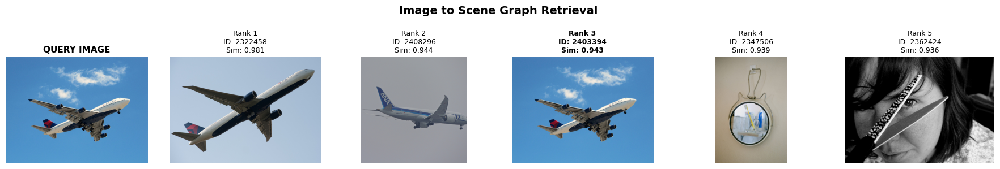




BEST QUERY #2 | Similarite maximale: 0.9765

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000075614.jpg
Image ID: 2322458

SCENE GRAPH DE LA QUERY :
  Objets (2) :
    [4934216] airplane
    [14140078] sky-other-merged
  Relations (1) :
    sky-other-merged --[over]--> airplane

--------------------------------------------------------------------------------

TOP-5 SCENES SIMILAIRES :

RANK 1 [SELF] | Image ID: 2322458 | Similarite: 0.9765
  Objets (2) :
    [4934216] airplane
    [14140078] sky-other-merged
  Relations (1) :
    sky-other-merged --[over]--> airplane

RANK 2  | Image ID: 2408296 | Similarite: 0.9440
  Objets (2) :
    [7759967] airplane
    [10459543] sky-other-merged
  Relations (1) :
    sky-other-merged --[over]--> airplane

RANK 3  | Image ID: 2392956 | Similarite: 0.9431
  Objets (2) :
    [4868690] horse
    [9276043] building-other-merged
  Relations (1) :
    horse --[in]--> building-other-merged

RANK 4  | Image ID: 2368260 | Similarite

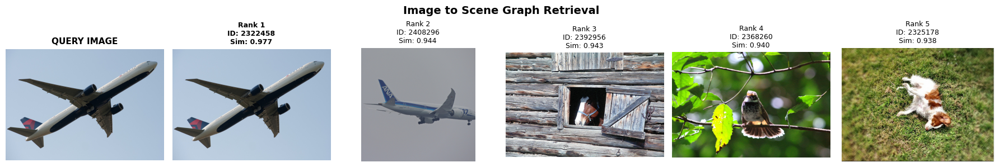




BEST QUERY #3 | Similarite maximale: 0.9740

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000528957.jpg
Image ID: 2375091

SCENE GRAPH DE LA QUERY :
  Objets (28) :
    [6643295] person
    [11250604] person
    [3290169] person
    [4216466] person
    [6184016] person
    [7961990] person
    [6051416] person
    [4089503] person
    [3619894] person
    [5131084] person
    ... et 18 autres objets
  Relations (8) :
    person --[standing on]--> road
    person --[walking on]--> road
    person --[standing on]--> road
    person --[holding]--> paper-merged
    truck --[driving on]--> road
    truck --[driving on]--> road
    roof --[on]--> building-other-merged
    sky-other-merged --[over]--> building-other-merged

--------------------------------------------------------------------------------

TOP-5 SCENES SIMILAIRES :

RANK 1  | Image ID: 2355551 | Similarite: 0.9740
  Objets (21) :
    [1051921] person
    [3353903] person
    [2367006] person
    [263069

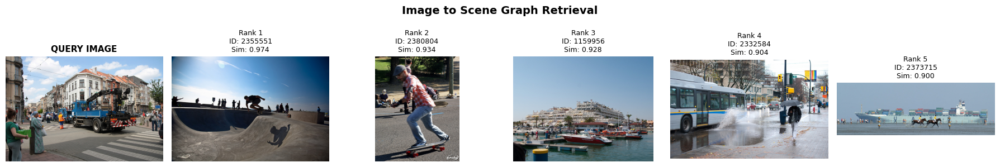




BEST QUERY #4 | Similarite maximale: 0.9740

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000112252.jpg
Image ID: 2324189

SCENE GRAPH DE LA QUERY :
  Objets (2) :
    [5524041] airplane
    [12622205] sky-other-merged
  Relations (1) :
    airplane --[flying over]--> sky-other-merged

--------------------------------------------------------------------------------

TOP-5 SCENES SIMILAIRES :

RANK 1  | Image ID: 2322458 | Similarite: 0.9740
  Objets (2) :
    [4934216] airplane
    [14140078] sky-other-merged
  Relations (1) :
    sky-other-merged --[over]--> airplane

RANK 2  | Image ID: 2362424 | Similarite: 0.9422
  Objets (2) :
    [5066061] person
    [5329233] scissors
  Relations (1) :
    person --[attached to]--> scissors

RANK 3  | Image ID: 2408296 | Similarite: 0.9394
  Objets (2) :
    [7759967] airplane
    [10459543] sky-other-merged
  Relations (1) :
    sky-other-merged --[over]--> airplane

RANK 4  | Image ID: 2339978 | Similarite: 0.9280
  Obj

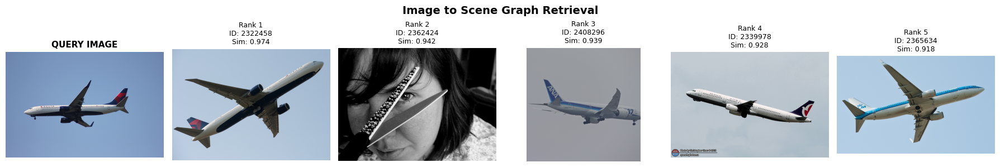




BEST QUERY #5 | Similarite maximale: 0.9697

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000334980.jpg
Image ID: 2362722

SCENE GRAPH DE LA QUERY :
  Objets (5) :
    [6518653] person
    [789515] person
    [5004373] tennis racket
    [6722166] playingfield
    [4672584] wall-other-merged
  Relations (1) :
    person --[standing on]--> playingfield

--------------------------------------------------------------------------------

TOP-5 SCENES SIMILAIRES :

RANK 1  | Image ID: 2371282 | Similarite: 0.9697
  Objets (4) :
    [8943484] person
    [8950700] sports ball
    [5329500] baseball bat
    [4154990] playingfield
  Relations (3) :
    person --[about to hit]--> sports ball
    person --[holding]--> baseball bat
    person --[walking on]--> playingfield

RANK 2  | Image ID: 2411485 | Similarite: 0.9681
  Objets (4) :
    [7237275] person
    [8380371] sports ball
    [6655628] tennis racket
    [6521467] playingfield
  Relations (3) :
    person --[holding

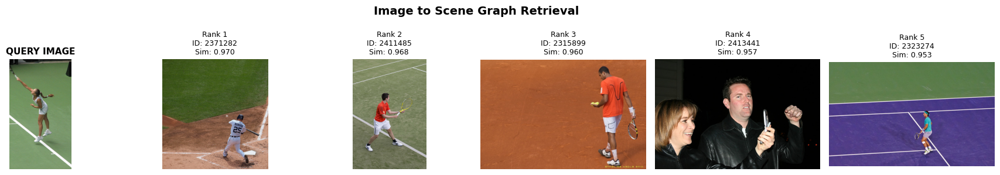




EXEMPLES : QUERIES ALEATOIRES


RANDOM QUERY #1

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000029839.jpg
Image ID: 2350041

SCENE GRAPH DE LA QUERY :
  Objets (8) :
    [3944280] person
    [2167079] person
    [1511197] person
    [4012629] person
    [6316437] fire hydrant
    [460297] backpack
    [7240606] road
    [6317203] pavement-merged
  Relations (6) :
    person --[on]--> pavement-merged
    person --[standing on]--> road
    person --[carrying]--> backpack
    person --[walking on]--> road
    fire hydrant --[on]--> pavement-merged
    road --[attached to]--> pavement-merged

--------------------------------------------------------------------------------

TOP-5 SCENES SIMILAIRES :

RANK 1  | Image ID: 2327007 | Similarite: 0.8494
  Objets (16) :
    [5067615] person
    [1843502] person
    [6245711] person
    [5723488] person
    [5332321] person
    [4076394] person
    [3289436] person
    [5537177] car
    [3027253] bus
    [10261648] truck


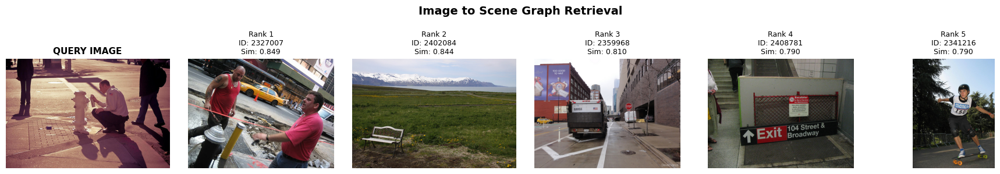




RANDOM QUERY #2

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\val2017\000000581100.jpg
Image ID: 2416337

SCENE GRAPH DE LA QUERY :
  Objets (10) :
    [4080461] cow
    [4607836] cow
    [4870241] giraffe
    [4674663] giraffe
    [7040363] tree-merged
    [16513785] sky-other-merged
    [6193530] grass-merged
    [8361369] dirt-merged
    [8158072] building-other-merged
    [7235430] rock-merged
  Relations (10) :
    cow --[in]--> grass-merged
    cow --[in]--> grass-merged
    giraffe --[beside]--> giraffe
    giraffe --[standing on]--> dirt-merged
    giraffe --[beside]--> tree-merged
    giraffe --[standing on]--> dirt-merged
    tree-merged --[enclosing]--> cow
    tree-merged --[in]--> grass-merged
    sky-other-merged --[over]--> rock-merged
    building-other-merged --[in front of]--> rock-merged

--------------------------------------------------------------------------------

TOP-5 SCENES SIMILAIRES :

RANK 1  | Image ID: 2397909 | Similarite: 0.8744
  Objets (7)

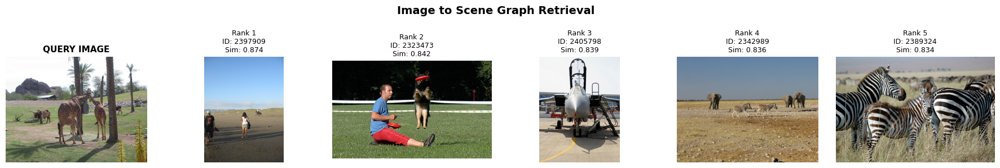




RANDOM QUERY #3

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000311691.jpg
Image ID: 2362118

SCENE GRAPH DE LA QUERY :
  Objets (36) :
    [8291729] person
    [11707540] boat
    [6184031] boat
    [9804184] boat
    [9996659] boat
    [8615513] boat
    [10985081] boat
    [10524557] boat
    [9603959] boat
    [12102812] boat
    ... et 26 autres objets
  Relations (12) :
    boat --[beside]--> boat
    boat --[beside]--> sand
    boat --[beside]--> sand
    boat --[beside]--> boat
    boat --[on]--> sea
    chair --[beside]--> chair
    chair --[on]--> sand
    chair --[beside]--> chair
    sea --[attached to]--> sand
    sky-other-merged --[over]--> house
    ... et 2 autres relations

--------------------------------------------------------------------------------

TOP-5 SCENES SIMILAIRES :

RANK 1  | Image ID: 2336649 | Similarite: 0.9362
  Objets (50) :
    [3030882] person
    [1186850] person
    [4737353] person
    [1910066] person
    [1713204] pe

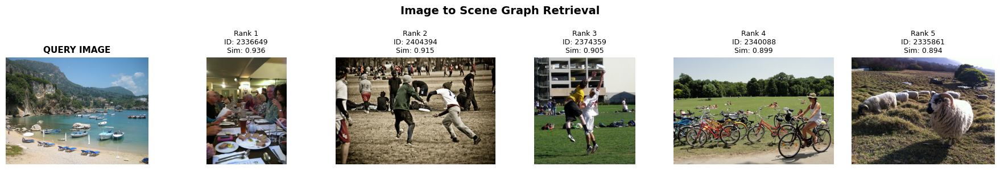



                                ANALYSE TERMINEE                                


In [ ]:

# ================================================================
# Retrieval : top 5 meilleures queries + exemples aléatoires


import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import pickle

print("="*80)
print("RETRIEVAL IMAGE -> SCENE GRAPH")
print("="*80 + "\n")

projector.eval()
resnet.eval()

print("Encoding du validation set en cours...")

all_z_imgs = []
all_z_graphs = []
all_img_ids = []
all_scene_graphs = []

with torch.no_grad():
    for img_emb, graph_emb, img_id in multimodal_val:
        img_emb = img_emb.unsqueeze(0).to(DEVICE)
        graph_emb = graph_emb.unsqueeze(0).to(DEVICE)
        
        z_img, z_graph = projector(img_emb, graph_emb)
        
        all_z_imgs.append(z_img.cpu())
        all_z_graphs.append(z_graph.cpu())
        all_img_ids.append(img_id)
        
        scene = scene_val.get(img_id, None)
        all_scene_graphs.append(scene)

all_z_imgs = torch.cat(all_z_imgs, dim=0).numpy()
all_z_graphs = torch.cat(all_z_graphs, dim=0).numpy()

graph_database = {
    'embeddings': all_z_graphs,
    'img_ids': all_img_ids,
    'scene_graphs': all_scene_graphs
}

print(f"Nombre de paires encodees : {len(all_img_ids)}")
print(f"Dimension embeddings : {all_z_imgs.shape[1]}\n")

def print_scene_graph(scene_graph, max_objects=10, max_relations=10):
    if scene_graph is None:
        print("  Scene graph non disponible")
        return
    objects = scene_graph.get('objects', [])
    print(f"  Objets ({len(objects)}) :")
    for i, obj in enumerate(objects[:max_objects]):
        obj_name = obj.get('name', 'unknown')
        obj_id = obj.get('object_id', obj.get('segment_id', '?'))
        print(f"    [{obj_id}] {obj_name}")
    if len(objects) > max_objects:
        print(f"    ... et {len(objects) - max_objects} autres objets")
    
    relations = scene_graph.get('relations', [])
    print(f"  Relations ({len(relations)}) :")
    for i, rel in enumerate(relations[:max_relations]):
        subj_id = rel.get('subject_id', '?')
        obj_id = rel.get('object_id', '?')
        predicate = rel.get('predicate', 'unknown')
        subj_name = next((o['name'] for o in objects if o.get('segment_id') == subj_id), f"obj_{subj_id}")
        obj_name = next((o['name'] for o in objects if o.get('segment_id') == obj_id), f"obj_{obj_id}")
        
        print(f"    {subj_name} --[{predicate}]--> {obj_name}")
    if len(relations) > max_relations:
        print(f"    ... et {len(relations) - max_relations} autres relations")

# Inférence
def inference_image_to_scene(image_path, query_img_id, top_k=5):
    """Inference avec une image query"""
    print("="*80)
    print(f"QUERY IMAGE: {image_path}")
    print(f"Image ID: {query_img_id}")
    print("="*80)
    
    query_scene = scene_val.get(query_img_id, None)
    print("\nSCENE GRAPH DE LA QUERY :")
    print_scene_graph(query_scene)
    print("\n" + "-"*80 + "\n")
    
    img_emb = encode_image_resnet(image_path, DEVICE).unsqueeze(0)
    
    with torch.no_grad():
        z_img, _ = projector(img_emb, torch.zeros(1, 128).to(DEVICE))
    
    z_img = z_img.cpu().numpy()
    
    similarities = z_img @ graph_database['embeddings'].T
    top_indices = np.argsort(-similarities[0])[:top_k]
    
    fig, axes = plt.subplots(1, top_k + 1, figsize=(3 * (top_k + 1), 3))
    
    img = Image.open(image_path).convert('RGB')
    axes[0].imshow(img)
    axes[0].set_title('QUERY IMAGE', fontweight='bold', fontsize=11)
    axes[0].axis('off')
    
    print(f"TOP-{top_k} SCENES SIMILAIRES :\n")
    for i, idx in enumerate(top_indices, 1):
        retrieved_img_id = graph_database['img_ids'][idx]
        retrieved_scene = graph_database['scene_graphs'][idx]
        sim_score = similarities[0, idx]
        
        is_correct = retrieved_img_id == query_img_id
        marker = "[SELF]" if is_correct else ""
        
        print(f"RANK {i} {marker} | Image ID: {retrieved_img_id} | Similarite: {sim_score:.4f}")
        print_scene_graph(retrieved_scene)
        print()
        
        retrieved_path = imageid_to_path_val.get(retrieved_img_id)
        if retrieved_path and retrieved_path.exists():
            img = Image.open(retrieved_path).convert('RGB')
            axes[i].imshow(img)
            axes[i].set_title(f'Rank {i}\nID: {retrieved_img_id}\nSim: {sim_score:.3f}', 
                            fontsize=9, fontweight='bold' if is_correct else 'normal')
        else:
            axes[i].text(0.5, 0.5, 'Not Found', ha='center', va='center')
            axes[i].set_title(f'Rank {i}', fontsize=9)
        
        axes[i].axis('off')
    
    plt.suptitle('Image to Scene Graph Retrieval', fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()
    print("\n" + "="*80 + "\n")


print("="*80)
print("RECHERCHE DU TOP 5 DES MEILLEURES QUERIES")
print("="*80 + "\n")

query_results = []
for idx in tqdm(range(len(all_img_ids)), desc="Testing all queries"):
    similarities = all_z_imgs[idx] @ all_z_graphs.T
    top_sim = similarities.max()
    img_path = imageid_to_path_val.get(all_img_ids[idx])
    query_results.append((top_sim, all_img_ids[idx], img_path))

query_results.sort(reverse=True, key=lambda x: x[0])
top_5_queries = query_results[:5]

print(f"\nTOP 5 MEILLEURES QUERIES :\n")
for rank, (sim, img_id, img_path) in enumerate(top_5_queries, 1):
    print(f"Rank {rank}: Image ID {img_id} | Similarite maximale: {sim:.4f}")
print()


print("\n" + "="*80)
print("EXEMPLES : TOP 5 MEILLEURES QUERIES")
print("="*80 + "\n")

for rank, (sim, query_id, query_path) in enumerate(top_5_queries, 1):
    print(f"\n{'='*80}")
    print(f"BEST QUERY #{rank} | Similarite maximale: {sim:.4f}")
    print(f"{'='*80}\n")
    
    if query_path and query_path.exists():
        inference_image_to_scene(query_path, query_id, top_k=5)

print("\n" + "="*80)
print("EXEMPLES : QUERIES ALEATOIRES")
print("="*80 + "\n")

np.random.seed(42)
n_random = 3

for i in range(n_random):
    test_idx = np.random.randint(0, len(all_img_ids))
    test_img_id = all_img_ids[test_idx]
    test_img_path = imageid_to_path_val.get(test_img_id)
    
    print(f"\n{'='*80}")
    print(f"RANDOM QUERY #{i+1}")
    print(f"{'='*80}\n")
    
    if test_img_path and test_img_path.exists():
        inference_image_to_scene(test_img_path, test_img_id, top_k=5)

print("="*80)
print("ANALYSE TERMINEE".center(80))
print("="*80)


### 10.8 Baseline: Retrieval avec ResNet seul

RETRIEVAL RESNET SEUL (BASELINE)

Encoding du validation set en cours...
Nombre d'embeddings encodes : 4787
Dimension embeddings        : 2048

RECHERCHE DU TOP 5 DES MEILLEURES QUERIES



Testing all queries: 100%|██████████| 4787/4787 [00:01<00:00, 3292.22it/s]



TOP 5 MEILLEURES QUERIES :

Rank 1: Image ID 2332696 | Similarite maximale: 1.0000
Rank 2: Image ID 2315421 | Similarite maximale: 1.0000
Rank 3: Image ID 2408010 | Similarite maximale: 1.0000
Rank 4: Image ID 2356833 | Similarite maximale: 1.0000
Rank 5: Image ID 2350972 | Similarite maximale: 1.0000


EXEMPLES : TOP 5 MEILLEURES QUERIES


BEST QUERY #1 | Similarite maximale: 1.0000

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000345668.jpg
Image ID: 2332696

SCENE GRAPH DE LA QUERY :
  Objets (2) :
    [7101553] person
    [2956064] tie
  Relations (1) :
    person --[wearing]--> tie

--------------------------------------------------------------------------------

TOP-5 IMAGES SIMILAIRES :

RANK 1 [SELF] | Image ID: 2332696 | Similarite: 1.0000
  Objets (2) :
    [7101553] person
    [2956064] tie
  Relations (1) :
    person --[wearing]--> tie

RANK 2  | Image ID: 2393248 | Similarite: 0.8997
  Objets (3) :
    [5129298] person
    [4470597] tie
    [8756387]

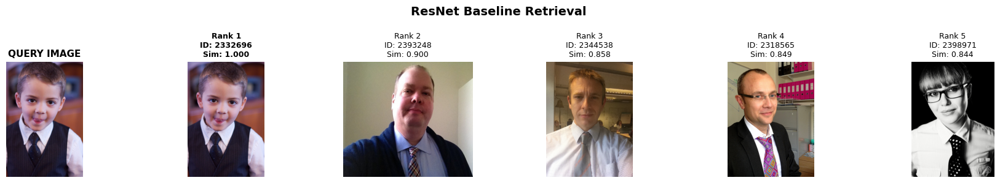




BEST QUERY #2 | Similarite maximale: 1.0000

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000001063.jpg
Image ID: 2315421

SCENE GRAPH DE LA QUERY :
  Objets (8) :
    [5988712] giraffe
    [6188160] house
    [7173227] tree-merged
    [4407875] fence-merged
    [16579836] sky-other-merged
    [5734522] grass-merged
    [9936297] dirt-merged
    [4013629] rock-merged
  Relations (6) :
    giraffe --[in front of]--> tree-merged
    giraffe --[on]--> grass-merged
    giraffe --[standing on]--> grass-merged
    fence-merged --[beside]--> rock-merged
    sky-other-merged --[over]--> tree-merged
    dirt-merged --[in front of]--> grass-merged

--------------------------------------------------------------------------------

TOP-5 IMAGES SIMILAIRES :

RANK 1 [SELF] | Image ID: 2315421 | Similarite: 1.0000
  Objets (8) :
    [5988712] giraffe
    [6188160] house
    [7173227] tree-merged
    [4407875] fence-merged
    [16579836] sky-other-merged
    [5734522] grass-mer

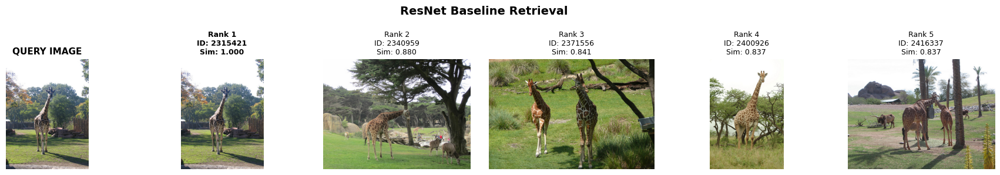




BEST QUERY #3 | Similarite maximale: 1.0000

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000495541.jpg
Image ID: 2408010

SCENE GRAPH DE LA QUERY :
  Objets (4) :
    [10399672] bird
    [8951969] bird
    [8491417] bird
    [8095630] water-other
  Relations (12) :
    bird --[attached to]--> bird
    bird --[in]--> water-other
    bird --[standing on]--> water-other
    bird --[looking at]--> water-other
    bird --[in front of]--> bird
    bird --[in front of]--> bird
    bird --[in]--> water-other
    bird --[walking on]--> water-other
    bird --[looking at]--> water-other
    bird --[in]--> water-other
    ... et 2 autres relations

--------------------------------------------------------------------------------

TOP-5 IMAGES SIMILAIRES :

RANK 1 [SELF] | Image ID: 2408010 | Similarite: 1.0000
  Objets (4) :
    [10399672] bird
    [8951969] bird
    [8491417] bird
    [8095630] water-other
  Relations (12) :
    bird --[attached to]--> bird
    bird --[in

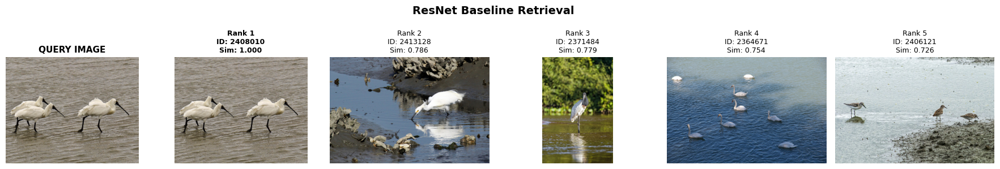




BEST QUERY #4 | Similarite maximale: 1.0000

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000031616.jpg
Image ID: 2356833

SCENE GRAPH DE LA QUERY :
  Objets (13) :
    [9010810] person
    [5062458] person
    [10730970] person
    [3632260] couch
    [8158855] tv
    [3490392] remote
    [8635341] blanket
    [3488836] cardboard
    [2635869] floor-wood
    [3953515] pillow
    ... et 3 autres objets
  Relations (6) :
    person --[holding]--> remote
    couch --[on]--> floor-wood
    couch --[attached to]--> wall-other-merged
    tv --[attached to]--> wall-other-merged
    pillow --[on]--> couch
    rug-merged --[on]--> floor-wood

--------------------------------------------------------------------------------

TOP-5 IMAGES SIMILAIRES :

RANK 1 [SELF] | Image ID: 2356833 | Similarite: 1.0000
  Objets (13) :
    [9010810] person
    [5062458] person
    [10730970] person
    [3632260] couch
    [8158855] tv
    [3490392] remote
    [8635341] blanket
    [3488

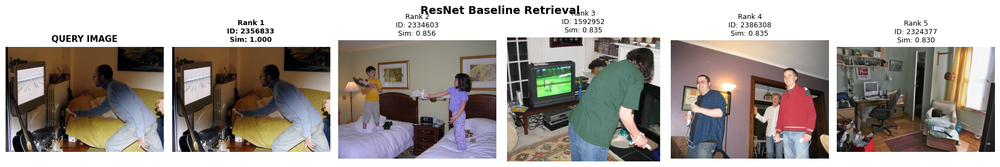




BEST QUERY #5 | Similarite maximale: 1.0000

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000215709.jpg
Image ID: 2350972

SCENE GRAPH DE LA QUERY :
  Objets (11) :
    [2637642] sink
    [2310492] counter
    [658451] door-stuff
    [8099487] light
    [1912379] mirror-stuff
    [7838377] towel
    [3367823] wall-brick
    [2111310] wall-tile
    [2044485] ceiling-merged
    [1119769] cabinet-merged
    ... et 1 autres objets
  Relations (5) :
    sink --[on]--> counter
    light --[hanging from]--> wall-tile
    mirror-stuff --[hanging from]--> wall-tile
    towel --[hanging from]--> wall-tile
    cabinet-merged --[in]--> wall-tile

--------------------------------------------------------------------------------

TOP-5 IMAGES SIMILAIRES :

RANK 1 [SELF] | Image ID: 2350972 | Similarite: 1.0000
  Objets (11) :
    [2637642] sink
    [2310492] counter
    [658451] door-stuff
    [8099487] light
    [1912379] mirror-stuff
    [7838377] towel
    [3367823] wall-br

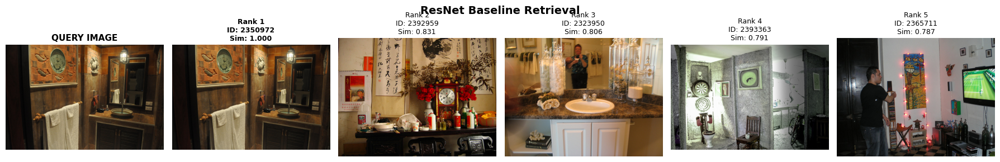




EXEMPLES : QUERIES ALEATOIRES


RANDOM QUERY #1

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000029839.jpg
Image ID: 2350041

SCENE GRAPH DE LA QUERY :
  Objets (8) :
    [3944280] person
    [2167079] person
    [1511197] person
    [4012629] person
    [6316437] fire hydrant
    [460297] backpack
    [7240606] road
    [6317203] pavement-merged
  Relations (6) :
    person --[on]--> pavement-merged
    person --[standing on]--> road
    person --[carrying]--> backpack
    person --[walking on]--> road
    fire hydrant --[on]--> pavement-merged
    road --[attached to]--> pavement-merged

--------------------------------------------------------------------------------

TOP-5 IMAGES SIMILAIRES :

RANK 1 [SELF] | Image ID: 2350041 | Similarite: 1.0000
  Objets (8) :
    [3944280] person
    [2167079] person
    [1511197] person
    [4012629] person
    [6316437] fire hydrant
    [460297] backpack
    [7240606] road
    [6317203] pavement-merged
  Relations (6) :

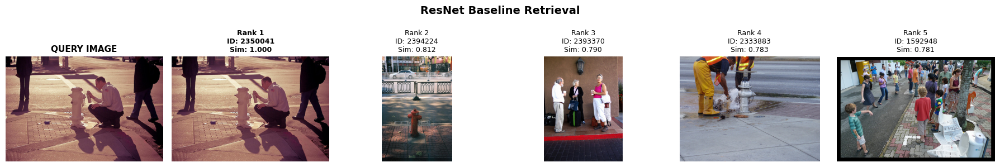




RANDOM QUERY #2

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\val2017\000000581100.jpg
Image ID: 2416337

SCENE GRAPH DE LA QUERY :
  Objets (10) :
    [4080461] cow
    [4607836] cow
    [4870241] giraffe
    [4674663] giraffe
    [7040363] tree-merged
    [16513785] sky-other-merged
    [6193530] grass-merged
    [8361369] dirt-merged
    [8158072] building-other-merged
    [7235430] rock-merged
  Relations (10) :
    cow --[in]--> grass-merged
    cow --[in]--> grass-merged
    giraffe --[beside]--> giraffe
    giraffe --[standing on]--> dirt-merged
    giraffe --[beside]--> tree-merged
    giraffe --[standing on]--> dirt-merged
    tree-merged --[enclosing]--> cow
    tree-merged --[in]--> grass-merged
    sky-other-merged --[over]--> rock-merged
    building-other-merged --[in front of]--> rock-merged

--------------------------------------------------------------------------------

TOP-5 IMAGES SIMILAIRES :

RANK 1 [SELF] | Image ID: 2416337 | Similarite: 1.0000
  Obje

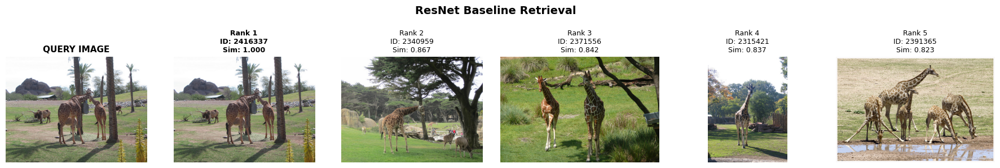




RANDOM QUERY #3

QUERY IMAGE: C:\Users\yassi\Desktop\MSI_Project\COCO\train2017\000000311691.jpg
Image ID: 2362118

SCENE GRAPH DE LA QUERY :
  Objets (36) :
    [8291729] person
    [11707540] boat
    [6184031] boat
    [9804184] boat
    [9996659] boat
    [8615513] boat
    [10985081] boat
    [10524557] boat
    [9603959] boat
    [12102812] boat
    ... et 26 autres objets
  Relations (12) :
    boat --[beside]--> boat
    boat --[beside]--> sand
    boat --[beside]--> sand
    boat --[beside]--> boat
    boat --[on]--> sea
    chair --[beside]--> chair
    chair --[on]--> sand
    chair --[beside]--> chair
    sea --[attached to]--> sand
    sky-other-merged --[over]--> house
    ... et 2 autres relations

--------------------------------------------------------------------------------

TOP-5 IMAGES SIMILAIRES :

RANK 1 [SELF] | Image ID: 2362118 | Similarite: 1.0000
  Objets (36) :
    [8291729] person
    [11707540] boat
    [6184031] boat
    [9804184] boat
    [9996659] b

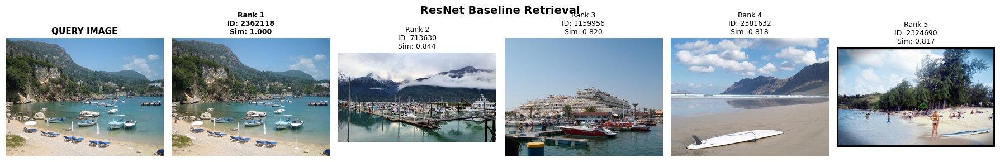



                                ANALYSE TERMINEE                                


In [ ]:
# ================================================================
# Retrieval ResNet seul (baseline) : top 5 meilleures queeries + exemples aléatoires

import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

print("="*80)
print("RETRIEVAL RESNET SEUL (BASELINE)")
print("="*80 + "\n")

resnet.eval()
print("Encoding du validation set en cours...")
all_resnet_imgs = []
all_img_ids_resnet = []
all_scene_graphs_resnet = []

with torch.no_grad():
    for img_emb, graph_emb, img_id in multimodal_val:
        all_resnet_imgs.append(img_emb.numpy())
        all_img_ids_resnet.append(img_id)
        
        scene = scene_val.get(img_id, None)
        all_scene_graphs_resnet.append(scene)

all_resnet_imgs = np.vstack(all_resnet_imgs)

all_resnet_imgs = all_resnet_imgs / np.linalg.norm(all_resnet_imgs, axis=1, keepdims=True)

resnet_database = {
    'embeddings': all_resnet_imgs,
    'img_ids': all_img_ids_resnet,
    'scene_graphs': all_scene_graphs_resnet
}

print(f"Nombre d'embeddings encodes : {len(all_img_ids_resnet)}")
print(f"Dimension embeddings        : {all_resnet_imgs.shape[1]}\n")

def print_scene_graph(scene_graph, max_objects=10, max_relations=10):
    if scene_graph is None:
        print("  Scene graph non disponible")
        return
    
    objects = scene_graph.get('objects', [])
    print(f"  Objets ({len(objects)}) :")
    for i, obj in enumerate(objects[:max_objects]):
        obj_name = obj.get('name', 'unknown')
        obj_id = obj.get('object_id', obj.get('segment_id', '?'))
        print(f"    [{obj_id}] {obj_name}")
    if len(objects) > max_objects:
        print(f"    ... et {len(objects) - max_objects} autres objets")
    
    relations = scene_graph.get('relations', [])
    print(f"  Relations ({len(relations)}) :")
    for i, rel in enumerate(relations[:max_relations]):
        subj_id = rel.get('subject_id', '?')
        obj_id = rel.get('object_id', '?')
        predicate = rel.get('predicate', 'unknown')
        
        subj_name = next((o['name'] for o in objects if o.get('segment_id') == subj_id), f"obj_{subj_id}")
        obj_name = next((o['name'] for o in objects if o.get('segment_id') == obj_id), f"obj_{obj_id}")
        
        print(f"    {subj_name} --[{predicate}]--> {obj_name}")
    if len(relations) > max_relations:
        print(f"    ... et {len(relations) - max_relations} autres relations")

# Inférence
def inference_resnet_only(image_path, query_img_id, top_k=5):
    """Inference avec ResNet seul"""
    print("="*80)
    print(f"QUERY IMAGE: {image_path}")
    print(f"Image ID: {query_img_id}")
    print("="*80)
    
    query_scene = scene_val.get(query_img_id, None)
    print("\nSCENE GRAPH DE LA QUERY :")
    print_scene_graph(query_scene)
    print("\n" + "-"*80 + "\n")
    
    img_emb = encode_image_resnet(image_path, DEVICE)
    img_emb_norm = img_emb.cpu().numpy() / np.linalg.norm(img_emb.cpu().numpy())
    
    similarities = img_emb_norm @ resnet_database['embeddings'].T
    top_indices = np.argsort(-similarities)[:top_k]
    
    fig, axes = plt.subplots(1, top_k + 1, figsize=(3 * (top_k + 1), 3))
    
    img = Image.open(image_path).convert('RGB')
    axes[0].imshow(img)
    axes[0].set_title('QUERY IMAGE', fontweight='bold', fontsize=11)
    axes[0].axis('off')
    
    print(f"TOP-{top_k} IMAGES SIMILAIRES :\n")
    for i, idx in enumerate(top_indices, 1):
        retrieved_img_id = resnet_database['img_ids'][idx]
        retrieved_scene = resnet_database['scene_graphs'][idx]
        sim_score = similarities[idx]
        
        is_correct = retrieved_img_id == query_img_id
        marker = "[SELF]" if is_correct else ""
        
        print(f"RANK {i} {marker} | Image ID: {retrieved_img_id} | Similarite: {sim_score:.4f}")
        print_scene_graph(retrieved_scene)
        print()
        
        retrieved_path = imageid_to_path_val.get(retrieved_img_id)
        if retrieved_path and retrieved_path.exists():
            img = Image.open(retrieved_path).convert('RGB')
            axes[i].imshow(img)
            axes[i].set_title(f'Rank {i}\nID: {retrieved_img_id}\nSim: {sim_score:.3f}', 
                            fontsize=9, fontweight='bold' if is_correct else 'normal')
        else:
            axes[i].text(0.5, 0.5, 'Not Found', ha='center', va='center')
            axes[i].set_title(f'Rank {i}', fontsize=9)
        
        axes[i].axis('off')
    
    plt.suptitle('ResNet Baseline Retrieval', fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()
    print("\n" + "="*80 + "\n")


print("="*80)
print("RECHERCHE DU TOP 5 DES MEILLEURES QUERIES")
print("="*80 + "\n")

query_results_resnet = []
for idx in tqdm(range(len(all_img_ids_resnet)), desc="Testing all queries"):
    similarities = all_resnet_imgs[idx] @ all_resnet_imgs.T
    top_sim = similarities.max()
    img_path = imageid_to_path_val.get(all_img_ids_resnet[idx])
    query_results_resnet.append((top_sim, all_img_ids_resnet[idx], img_path))

query_results_resnet.sort(reverse=True, key=lambda x: x[0])
top_5_queries_resnet = query_results_resnet[:5]

print(f"\nTOP 5 MEILLEURES QUERIES :\n")
for rank, (sim, img_id, img_path) in enumerate(top_5_queries_resnet, 1):
    print(f"Rank {rank}: Image ID {img_id} | Similarite maximale: {sim:.4f}")
print()

print("\n" + "="*80)
print("EXEMPLES : TOP 5 MEILLEURES QUERIES")
print("="*80 + "\n")

for rank, (sim, query_id, query_path) in enumerate(top_5_queries_resnet, 1):
    print(f"\n{'='*80}")
    print(f"BEST QUERY #{rank} | Similarite maximale: {sim:.4f}")
    print(f"{'='*80}\n")
    
    if query_path and query_path.exists():
        inference_resnet_only(query_path, query_id, top_k=5)

print("\n" + "="*80)
print("EXEMPLES : QUERIES ALEATOIRES")
print("="*80 + "\n")

np.random.seed(42)
n_random = 3

for i in range(n_random):
    test_idx = np.random.randint(0, len(all_img_ids_resnet))
    test_img_id = all_img_ids_resnet[test_idx]
    test_img_path = imageid_to_path_val.get(test_img_id)
    
    print(f"\n{'='*80}")
    print(f"RANDOM QUERY #{i+1}")
    print(f"{'='*80}\n")
    
    if test_img_path and test_img_path.exists():
        inference_resnet_only(test_img_path, test_img_id, top_k=5)

print("="*80)
print("ANALYSE TERMINEE".center(80))
print("="*80)


In [ ]:
# Calculer la variance de chaque dimension
variances = np.var(graph_embeddings, axis=0)

print("Variance par dimension:")
print(f"  Min: {variances.min():.6f}")
print(f"  Max: {variances.max():.6f}")
print(f"  Mean: {variances.mean():.6f}")



Variance par dimension:
  Min: 0.000000
  Max: 0.006675
  Mean: 0.001403


COMPARAISON MODELE ALIGNE vs RESNET BASELINE

TESTS COMPARATIFS


EXEMPLE #1 | Query ID: 2332696

COMPARAISON POUR QUERY IMAGE: 2332696



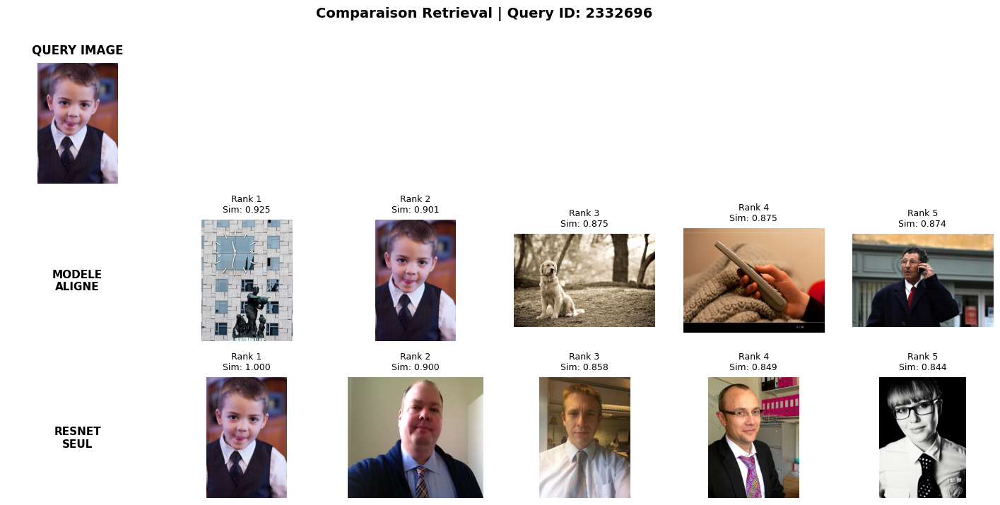


--------------------------------------------------------------------------------
SCENE GRAPHS
--------------------------------------------------------------------------------

QUERY (ID: 2332696):
    person - wearing - tie


MODELE ALIGNE - Top 5 Retrieved:
----------------------------------------

  Rank 1 | ID: 2332137 | Sim: 0.9250
    clock - on - building-other-merged

  Rank 2 | ID: 2332696 | Sim: 0.9011
    person - wearing - tie

  Rank 3 | ID: 2413162 | Sim: 0.8750
    dog - on - dirt-merged

  Rank 4 | ID: 2410520 | Sim: 0.8749
    person - holding - remote

  Rank 5 | ID: 2370856 | Sim: 0.8744
    person - wearing - tie
    person - holding - cell phone


RESNET SEUL - Top 5 Retrieved:
----------------------------------------

  Rank 1 | ID: 2332696 | Sim: 1.0000
    person - wearing - tie

  Rank 2 | ID: 2393248 | Sim: 0.8997
    person - wearing - tie
    person - in front of - wall-other-merged

  Rank 3 | ID: 2344538 | Sim: 0.8578
    person - beside - person
    perso

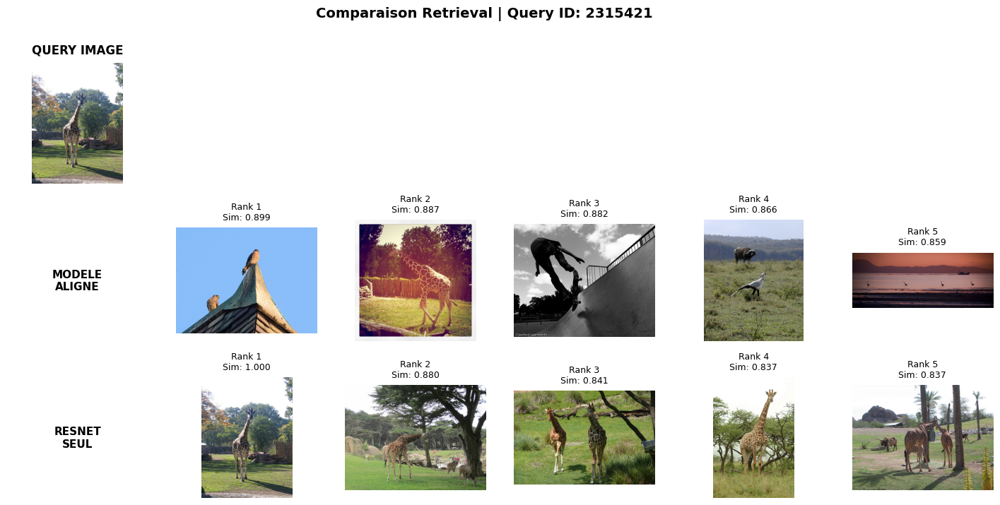


--------------------------------------------------------------------------------
SCENE GRAPHS
--------------------------------------------------------------------------------

QUERY (ID: 2315421):
    giraffe - in front of - tree-merged
    giraffe - on - grass-merged
    giraffe - standing on - grass-merged
    fence-merged - beside - rock-merged
    sky-other-merged - over - tree-merged
    ... et 1 autres relations


MODELE ALIGNE - Top 5 Retrieved:
----------------------------------------

  Rank 1 | ID: 2357108 | Sim: 0.8986
    bird - standing on - roof
    bird - standing on - roof
    sky-other-merged - over - bird
    ... et 3 autres relations

  Rank 2 | ID: 2401964 | Sim: 0.8869
    giraffe - in front of - fence-merged
    giraffe - attached to - grass-merged
    giraffe - walking on - grass-merged
    ... et 4 autres relations

  Rank 3 | ID: 2362272 | Sim: 0.8820
    person - on - skateboard
    bench - on - pavement-merged
    sky-other-merged - over - person
    ... et 

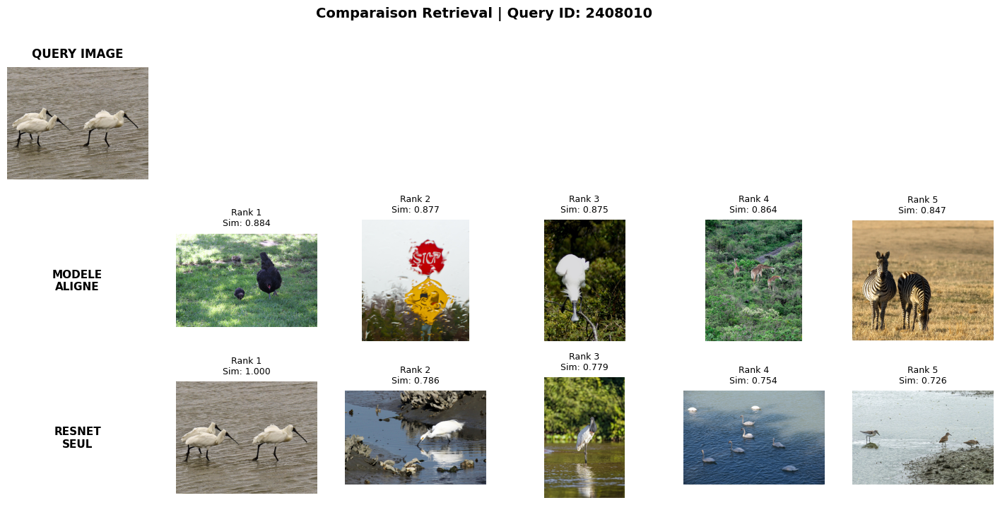


--------------------------------------------------------------------------------
SCENE GRAPHS
--------------------------------------------------------------------------------

QUERY (ID: 2408010):
    bird - attached to - bird
    bird - in - water-other
    bird - standing on - water-other
    bird - looking at - water-other
    bird - in front of - bird
    ... et 7 autres relations


MODELE ALIGNE - Top 5 Retrieved:
----------------------------------------

  Rank 1 | ID: 2380898 | Sim: 0.8841
    bird - walking on - grass-merged
    bird - standing on - grass-merged
    bird - standing on - grass-merged

  Rank 2 | ID: 2320730 | Sim: 0.8771
    sky-other-merged - over - stop sign

  Rank 3 | ID: 2388227 | Sim: 0.8750
    bird - standing on - tree-merged

  Rank 4 | ID: 2340046 | Sim: 0.8637
    giraffe - in - tree-merged
    giraffe - standing on - tree-merged
    giraffe - standing on - tree-merged
    ... et 1 autres relations

  Rank 5 | ID: 2415080 | Sim: 0.8473
    zebra - be

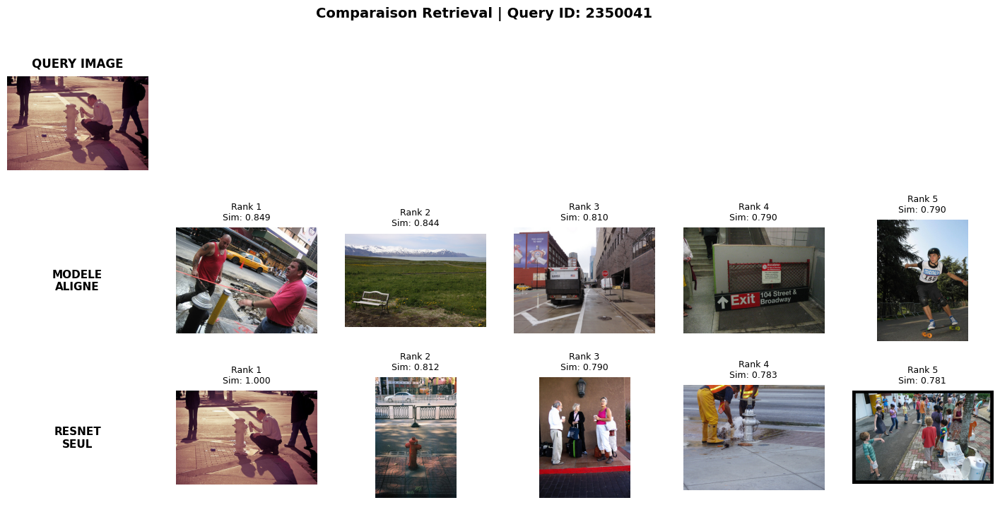


--------------------------------------------------------------------------------
SCENE GRAPHS
--------------------------------------------------------------------------------

QUERY (ID: 2350041):
    person - on - pavement-merged
    person - standing on - road
    person - carrying - backpack
    person - walking on - road
    fire hydrant - on - pavement-merged
    ... et 1 autres relations


MODELE ALIGNE - Top 5 Retrieved:
----------------------------------------

  Rank 1 | ID: 2327007 | Sim: 0.8494
    person - on - pavement-merged
    person - walking on - pavement-merged
    person - walking on - pavement-merged
    ... et 5 autres relations

  Rank 2 | ID: 2402084 | Sim: 0.8435
    bench - on - dirt-merged
    sea - beside - mountain-merged
    sky-other-merged - over - mountain-merged
    ... et 1 autres relations

  Rank 3 | ID: 2359968 | Sim: 0.8102
    car - on - road
    car - parked on - road
    car - parked on - pavement-merged
    ... et 4 autres relations

  Rank 4

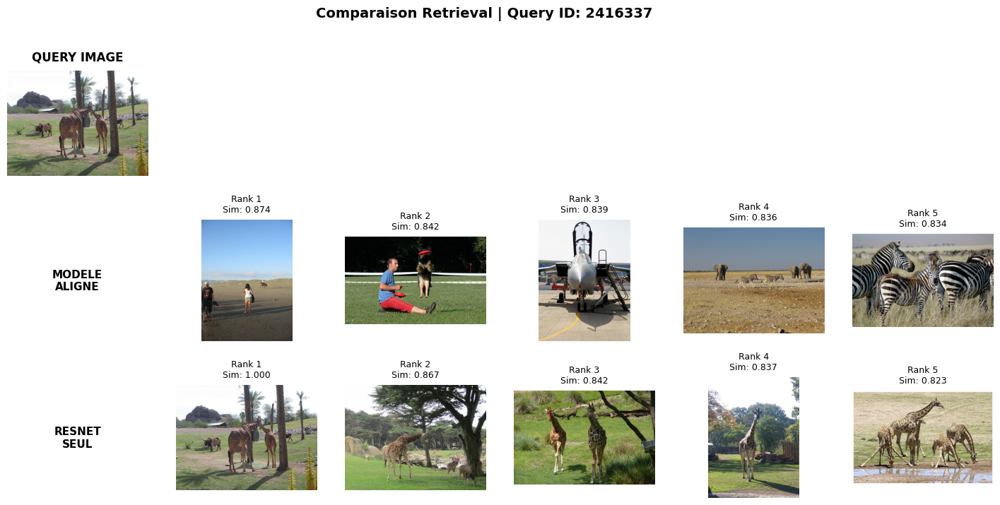


--------------------------------------------------------------------------------
SCENE GRAPHS
--------------------------------------------------------------------------------

QUERY (ID: 2416337):
    cow - in - grass-merged
    cow - in - grass-merged
    giraffe - beside - giraffe
    giraffe - standing on - dirt-merged
    giraffe - beside - tree-merged
    ... et 5 autres relations


MODELE ALIGNE - Top 5 Retrieved:
----------------------------------------

  Rank 1 | ID: 2397909 | Sim: 0.8744
    person - standing on - sand
    person - in front of - horse
    person - standing on - sand
    ... et 4 autres relations

  Rank 2 | ID: 2323473 | Sim: 0.8423
    person - holding - frisbee
    person - over - grass-merged
    dog - biting - frisbee
    ... et 2 autres relations

  Rank 3 | ID: 2405798 | Sim: 0.8388
    person - on - airplane
    person - sitting on - airplane
    airplane - parked on - road
    ... et 4 autres relations

  Rank 4 | ID: 2342989 | Sim: 0.8358
    elepha

In [ ]:
# ================================================================
# Comparaison visuelle des résultats de retrieval entre le modèle aligné et ResNet seul

import matplotlib.pyplot as plt
from PIL import Image
import numpy as np

print("="*80)
print("COMPARAISON MODELE ALIGNE vs RESNET BASELINE")
print("="*80 + "\n")

projector.eval()
resnet.eval()

def print_scene_graph_compact(scene_graph, max_relations=5):
    if scene_graph is None:
        print("  Scene graph non disponible")
        return
    
    objects = {obj['segment_id']: obj['name'] for obj in scene_graph.get('objects', [])}
    relations = scene_graph.get('relations', [])
    
    for i, rel in enumerate(relations[:max_relations]):
        subj_id = rel.get('subject_id', '?')
        obj_id = rel.get('object_id', '?')
        predicate = rel.get('predicate', 'unknown')
        
        subj_name = objects.get(subj_id, f"obj_{subj_id}")
        obj_name = objects.get(obj_id, f"obj_{obj_id}")
        
        print(f"    {subj_name} - {predicate} - {obj_name}")
    
    if len(relations) > max_relations:
        print(f"    ... et {len(relations) - max_relations} autres relations")


def compare_retrievals(image_path, query_img_id, top_k=5):    
    print("="*80)
    print(f"COMPARAISON POUR QUERY IMAGE: {query_img_id}")
    print("="*80 + "\n")
        
    img_emb = encode_image_resnet(image_path, DEVICE).unsqueeze(0)
    
    with torch.no_grad():
        z_img, _ = projector(img_emb, torch.zeros(1, 128).to(DEVICE))
    z_img = z_img.cpu().numpy()
    
    similarities_aligned = z_img @ graph_database['embeddings'].T
    top_indices_aligned = np.argsort(-similarities_aligned[0])[:top_k]
    
    img_emb_norm = img_emb.squeeze(0).cpu().numpy() / np.linalg.norm(img_emb.squeeze(0).cpu().numpy())
    similarities_resnet = img_emb_norm @ resnet_database['embeddings'].T
    top_indices_resnet = np.argsort(-similarities_resnet)[:top_k]
    
    fig, axes = plt.subplots(3, top_k + 1, figsize=(3 * (top_k + 1), 8))
  
    for col in range(top_k + 1):
        if col == 0:
            img = Image.open(image_path).convert('RGB')
            axes[0, col].imshow(img)
            axes[0, col].set_title('QUERY IMAGE', fontweight='bold', fontsize=12, pad=10)
        axes[0, col].axis('off')
    
    axes[1, 0].text(0.5, 0.5, 'MODELE\nALIGNE', ha='center', va='center', 
                    fontweight='bold', fontsize=11)
    axes[1, 0].axis('off')
    
    for i, idx in enumerate(top_indices_aligned, 1):
        retrieved_img_id = graph_database['img_ids'][idx]
        sim_score = similarities_aligned[0, idx]
        
        retrieved_path = imageid_to_path_val.get(retrieved_img_id)
        if retrieved_path and retrieved_path.exists():
            img = Image.open(retrieved_path).convert('RGB')
            axes[1, i].imshow(img)
            axes[1, i].set_title(f'Rank {i}\nSim: {sim_score:.3f}', fontsize=9, pad=8)
        else:
            axes[1, i].text(0.5, 0.5, 'Not Found', ha='center', va='center')
            axes[1, i].set_title(f'Rank {i}', fontsize=9)
        
        axes[1, i].axis('off')
    

    axes[2, 0].text(0.5, 0.5, 'RESNET\nSEUL', ha='center', va='center', 
                    fontweight='bold', fontsize=11)
    axes[2, 0].axis('off')
    
    for i, idx in enumerate(top_indices_resnet, 1):
        retrieved_img_id = resnet_database['img_ids'][idx]
        sim_score = similarities_resnet[idx]
        
        retrieved_path = imageid_to_path_val.get(retrieved_img_id)
        if retrieved_path and retrieved_path.exists():
            img = Image.open(retrieved_path).convert('RGB')
            axes[2, i].imshow(img)
            axes[2, i].set_title(f'Rank {i}\nSim: {sim_score:.3f}', fontsize=9, pad=8)
        else:
            axes[2, i].text(0.5, 0.5, 'Not Found', ha='center', va='center')
            axes[2, i].set_title(f'Rank {i}', fontsize=9)
        
        axes[2, i].axis('off')
    
    plt.suptitle(f'Comparaison Retrieval | Query ID: {query_img_id}', 
                fontsize=14, fontweight='bold', y=0.98)
    plt.subplots_adjust(hspace=0.3, wspace=0.2)
    plt.show()
    
    print("\n" + "-"*80)
    print("SCENE GRAPHS")
    print("-"*80 + "\n")

    query_scene = scene_val.get(query_img_id, None)
    print(f"QUERY (ID: {query_img_id}):")
    print_scene_graph_compact(query_scene, max_relations=5)
    print()
    
    print("\nMODELE ALIGNE - Top 5 Retrieved:")
    print("-" * 40)
    for i, idx in enumerate(top_indices_aligned, 1):
        retrieved_img_id = graph_database['img_ids'][idx]
        retrieved_scene = graph_database['scene_graphs'][idx]
        sim_score = similarities_aligned[0, idx]
        
        print(f"\n  Rank {i} | ID: {retrieved_img_id} | Sim: {sim_score:.4f}")
        print_scene_graph_compact(retrieved_scene, max_relations=3)
    
    print("\n\nRESNET SEUL - Top 5 Retrieved:")
    print("-" * 40)
    for i, idx in enumerate(top_indices_resnet, 1):
        retrieved_img_id = resnet_database['img_ids'][idx]
        retrieved_scene = resnet_database['scene_graphs'][idx]
        sim_score = similarities_resnet[idx]
        
        print(f"\n  Rank {i} | ID: {retrieved_img_id} | Sim: {sim_score:.4f}")
        print_scene_graph_compact(retrieved_scene, max_relations=3)
    
    print("\n" + "="*80 + "\n")


print("="*80)
print("TESTS COMPARATIFS")
print("="*80 + "\n")

n_examples = 3

for rank in range(n_examples):
    sim, query_id, query_path = top_5_queries[rank]
    
    print(f"\n{'='*80}")
    print(f"EXEMPLE #{rank+1} | Query ID: {query_id}")
    print(f"{'='*80}\n")
    
    if query_path and query_path.exists():
        compare_retrievals(query_path, query_id, top_k=5)

# test sur queries aléatoires

print("\n" + "="*80)
print("EXEMPLES ALEATOIRES")
print("="*80 + "\n")

np.random.seed(42)
n_random = 2

for i in range(n_random):
    test_idx = np.random.randint(0, len(all_img_ids))
    test_img_id = all_img_ids[test_idx]
    test_img_path = imageid_to_path_val.get(test_img_id)
    
    print(f"\n{'='*80}")
    print(f"RANDOM QUERY #{i+1} | Query ID: {test_img_id}")
    print(f"{'='*80}\n")
    
    if test_img_path and test_img_path.exists():
        compare_retrievals(test_img_path, test_img_id, top_k=5)

print("="*80)
print("COMPARAISON TERMINEE".center(80))
print("="*80)
